<a href="https://colab.research.google.com/github/Silence-o0/XRayChestClassification/blob/main/labxray.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("silenceo0/chest-xray-dataset")

print("Path to dataset files:", path)

Using Colab cache for faster access to the 'chest-xray-dataset' dataset.
Path to dataset files: /kaggle/input/chest-xray-dataset


# Model 1: RandomForest

In [ ]:
import os
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score, classification_report, confusion_matrix, precision_recall_curve

from sklearn.utils.class_weight import compute_class_weight
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm
from PIL import Image
import joblib

import matplotlib.pyplot as plt
import seaborn as sns

Loading dataset and preprocessing images

In [ ]:
def preprocess_image(image_path, target_size):
    try:
        img = Image.open(image_path).convert('L')
        img = img.resize(target_size, Image.Resampling.LANCZOS)
        img_array = np.array(img) / 255.0

        min_val, max_val = np.min(img_array), np.max(img_array)
        if max_val > min_val:
            img_array = (img_array - min_val) / (max_val - min_val)

        return img_array.flatten()
    except Exception as e:
        print(f"Processing error {image_path}: {e}")
        return None

In [ ]:
def load_dataset(split, image_size):
    X, y, class_names = [], [], []
    split_dir = os.path.join(path, split)

    class_names = sorted([d for d in os.listdir(split_dir) if os.path.isdir(os.path.join(split_dir, d))])

    for cls in tqdm(class_names):
        cls_dir = os.path.join(split_dir, cls)
        image_files = [f for f in os.listdir(cls_dir) if f.lower().endswith((".png", ".jpg", ".jpeg"))]

        for f in image_files:
            img_path = os.path.join(cls_dir, f)
            processed_img = preprocess_image(img_path, image_size)
            if processed_img is not None:
                X.append(processed_img)
                y.append(cls)
    return np.array(X), np.array(y), class_names

In [ ]:
def optimize_random_forest(X_train, y_train, X_val, y_val):
    param_grid = {
        'n_estimators': [200],
        'max_depth': [10, 15],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [2, 4],
        'bootstrap': [False]
    }

    best_score = 0
    best_params = {}
    best_model = None

    for max_d in param_grid['max_depth']:
        for min_split in param_grid['min_samples_split']:
            for min_leaf in param_grid['min_samples_leaf']:

                model = RandomForestClassifier(
                    n_estimators=200,
                    max_depth=max_d,
                    min_samples_split=min_split,
                    min_samples_leaf=min_leaf,
                    bootstrap=False,
                    class_weight='balanced',
                    random_state=42,
                    n_jobs=-1
                )

                model.fit(X_train, y_train)
                y_val_proba = model.predict_proba(X_val)[:, 1]
                val_ap = average_precision_score(y_val, y_val_proba)

                if val_ap > best_score:
                    best_score = val_ap
                    best_params = {
                        'max_depth': max_d,
                        'min_samples_split': min_split,
                        'min_samples_leaf': min_leaf
                    }
                    best_model = model

    print(f"Best hyperparameters: {best_params}")
    print(f"Best average precision on validation: {best_score:.4f}")
    return best_model

Training and validation

In [ ]:
image_size = (128, 128)

X_train, y_train, classes = load_dataset("train", image_size)
X_val, y_val, _ = load_dataset("val", image_size)
all_models_data = {}

diseases = [cls for cls in classes if cls != "Normal"]
print(f"All classes for training: {diseases}")

for disease in diseases:
    print(f"\nTraining {disease} vs Normal")
    if disease not in y_train or "Normal" not in y_train:
        continue

    train_idx = np.where((y_train == disease) | (y_train == "Normal"))[0]
    X_tr, y_tr = X_train[train_idx], y_train[train_idx]
    y_tr_binary = np.where(y_tr == disease, 1, 0)

    val_idx = np.where((y_val == disease) | (y_val == "Normal"))[0]
    X_v, y_v = X_val[val_idx], y_val[val_idx]
    y_v_binary = np.where(y_v == disease, 1, 0)

    scaler = StandardScaler()
    X_tr_scaled = scaler.fit_transform(X_tr)
    X_v_scaled = scaler.transform(X_v)


    best_model = optimize_random_forest(X_tr_scaled, y_tr_binary, X_v_scaled, y_v_binary)

    y_val_pred = best_model.predict(X_v_scaled)
    y_val_proba = best_model.predict_proba(X_v_scaled)[:, 1]

    val_metrics = {
        'accuracy': accuracy_score(y_v_binary, y_val_pred),
        'precision': precision_score(y_v_binary, y_val_pred, zero_division=0),
        'recall': recall_score(y_v_binary, y_val_pred, zero_division=0),
        'f1': f1_score(y_v_binary, y_val_pred, zero_division=0),
        'roc_auc': roc_auc_score(y_v_binary, y_val_proba),
        'pr_auc': average_precision_score(y_v_binary, y_val_proba)
    }

    print(f"Validation {disease}:")
    for metric, value in val_metrics.items():
        print(f"  {metric.capitalize()}: {value:.4f}")

    all_models_data[disease] = {
        'disease': disease,
        'scaler': scaler,
        'model': best_model,
        'val_metrics': val_metrics,
        'feature_dimension': X_tr.shape[1],
    }

joblib.dump(all_models_data, "randomforest_models.pkl")

100%|██████████| 6/6 [01:02<00:00, 10.45s/it]


All classes for training: ['Cardiomegaly', 'Edema', 'Effusion', 'Pneumonia', 'Pneumothorax']

Training Cardiomegaly vs Normal
Best hyperparameters: {'max_depth': 15, 'min_samples_split': 5, 'min_samples_leaf': 2}
Best average precision on validation: 0.7776
Validation Cardiomegaly:
  Accuracy: 0.7517
  Precision: 0.7354
  Recall: 0.7548
  F1: 0.7450
  Roc_auc: 0.8160
  Pr_auc: 0.7776

Training Edema vs Normal
Best hyperparameters: {'max_depth': 15, 'min_samples_split': 10, 'min_samples_leaf': 4}
Best average precision on validation: 0.8218
Validation Edema:
  Accuracy: 0.7962
  Precision: 0.7699
  Recall: 0.7565
  F1: 0.7632
  Roc_auc: 0.8698
  Pr_auc: 0.8218

Training Effusion vs Normal
Best hyperparameters: {'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 2}
Best average precision on validation: 0.7815
Validation Effusion:
  Accuracy: 0.7522
  Precision: 0.7473
  Recall: 0.7622
  F1: 0.7547
  Roc_auc: 0.8121
  Pr_auc: 0.7815

Training Pneumonia vs Normal
Best hyperparame

['randomforest_models.pkl']

Model testing

In [ ]:
def test_models(models_path, X_test, y_test, image_size=(128, 128)):
    try:
        all_models_data = joblib.load(models_path)
        diseases = list(all_models_data.keys())
    except Exception as e:
        print(f"Error loading models: {e}")
        return {}

    test_results = {}
    confusion_matrices = {}
    all_probabilities = {}

    for disease in diseases:
        try:
            model_data = all_models_data[disease]
            model = model_data['model']
            scaler = model_data['scaler']

            test_idx = np.where((y_test == disease) | (y_test == "Normal"))[0]
            X_te, y_te = X_test[test_idx], y_test[test_idx]
            y_te_binary = np.where(y_te == disease, 1, 0)

            X_te_scaled = scaler.transform(X_te)

            y_test_pred = model.predict(X_te_scaled)
            y_test_proba = model.predict_proba(X_te_scaled)[:, 1]

            cm = confusion_matrix(y_te_binary, y_test_pred)
            confusion_matrices[disease] = cm

            all_probabilities[disease] = {
                'probabilities': y_test_proba,
                'true_labels': y_te_binary
            }

            test_metrics = {
                'accuracy': accuracy_score(y_te_binary, y_test_pred),
                'precision': precision_score(y_te_binary, y_test_pred, zero_division=0),
                'recall': recall_score(y_te_binary, y_test_pred, zero_division=0),
                'f1': f1_score(y_te_binary, y_test_pred, zero_division=0),
                'auc': roc_auc_score(y_te_binary, y_test_proba),
                'pr_auc': average_precision_score(y_te_binary, y_test_proba)
            }

            visualize_feature_importance_on_image(model, disease, X_test, y_test, image_size, test_metrics)
            test_results[disease] = test_metrics
        except Exception as e:
            print(f"Error in testing {disease}: {e}")

    visualize_confusion_matrices(confusion_matrices)
    if test_results:
        visualize_pr_auc(test_results, all_probabilities)
    return test_results

def visualize_feature_importance_on_image(model, disease, X_test, y_test, image_size, disease_metrics):
    disease_idx = np.where(y_test == disease)[0]

    if len(disease_idx) == 0:
        print(f"No {disease} images found")
        return

    sample_idx = disease_idx[0]
    sample_image = X_test[sample_idx].reshape(image_size)
    importances = model.feature_importances_.reshape(image_size)

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(sample_image, cmap='gray')
    axes[0].set_title(f'Original image\n{disease}', fontweight='bold')
    axes[0].axis('off')

    im = axes[1].imshow(importances, cmap='hot')
    axes[1].set_title(f'Pixel Importance\n{disease}', fontweight='bold')
    axes[1].axis('off')
    plt.colorbar(im, ax=axes[1], fraction=0.046, pad=0.04)

    axes[2].imshow(sample_image, cmap='gray', alpha=0.7)
    im_overlay = axes[2].imshow(importances, cmap='hot', alpha=0.7)
    axes[2].set_title(f'Overlay\n{disease}', fontweight='bold')
    axes[2].axis('off')
    plt.colorbar(im_overlay, ax=axes[2], fraction=0.046, pad=0.04)
    plt.tight_layout()
    plt.show()
    print(f"Accuracy: {disease_metrics['accuracy']:.4f}, PR_auc: {disease_metrics['pr_auc']:.4f}")

def visualize_confusion_matrices(confusion_matrices):
    diseases = list(confusion_matrices.keys())
    n_rows = 2
    n_cols = 3
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 5))

    for i, disease in enumerate(diseases):
        if i >= n_rows * n_cols:
            break
        row = i // n_cols
        col = i % n_cols
        ax = axes[row, col]

        cm = confusion_matrices[disease]
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax,
                   xticklabels=['Normal', disease],
                   yticklabels=['Normal', disease])

        ax.set_title(f'{disease}\nConfusion Matrix', fontweight='bold', fontsize=14)
        ax.set_xlabel('Predicted', fontsize=9)
        ax.set_ylabel('Actual', fontsize=9)

    for i in range(len(diseases), n_rows * n_cols):
        row = i // n_cols
        col = i % n_cols
        axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

def visualize_pr_auc(test_results, all_probabilities):
    plt.figure(figsize=(8, 5))
    colors = plt.cm.Set3(np.linspace(0, 1, len(test_results)))

    for i, (disease, metrics) in enumerate(test_results.items()):
        prob_data = all_probabilities[disease]
        y_proba = prob_data['probabilities']
        y_te_binary = prob_data['true_labels']

        precision, recall, _ = precision_recall_curve(y_te_binary, y_proba)
        pr_auc = metrics['pr_auc']

        plt.plot(recall, precision, color=colors[i], linewidth=2, label=f'{disease} (AP = {pr_auc:.3f})')

    plt.xlabel('Recall', fontsize=12, fontweight='bold')
    plt.ylabel('Precision', fontsize=12, fontweight='bold')
    plt.title('PR Curves for all classes', fontsize=14, fontweight='bold')

    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])

    plt.tight_layout()
    plt.show()

100%|██████████| 6/6 [01:12<00:00, 12.13s/it]


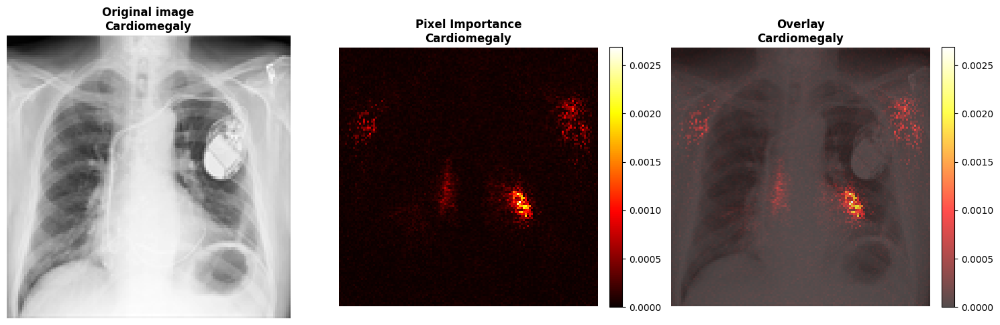

Accuracy: 0.7774, PR_auc: 0.8349


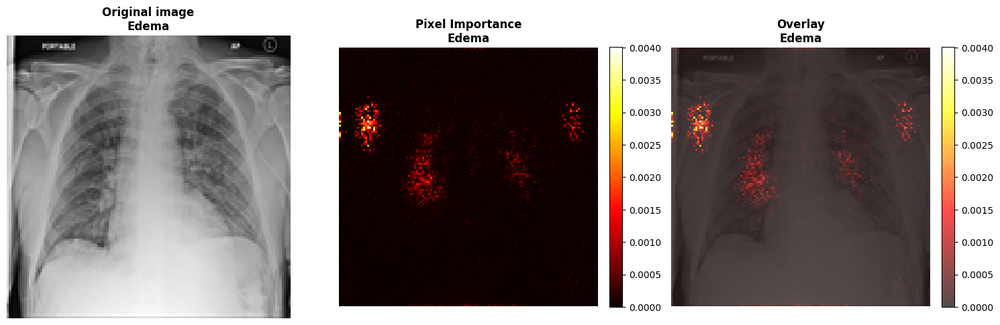

Accuracy: 0.8166, PR_auc: 0.8376


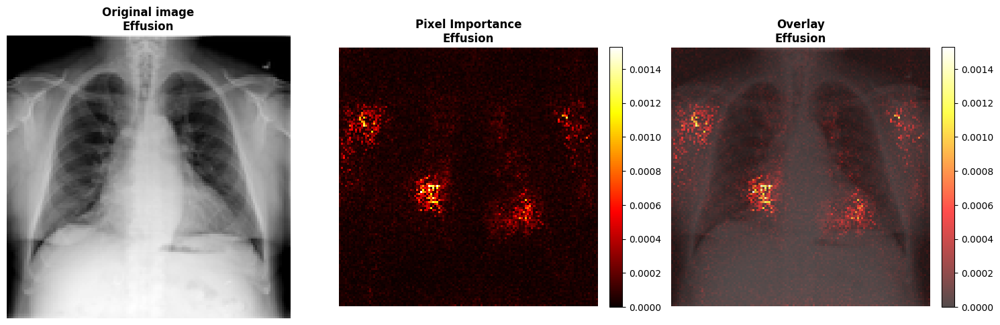

Accuracy: 0.7378, PR_auc: 0.7775


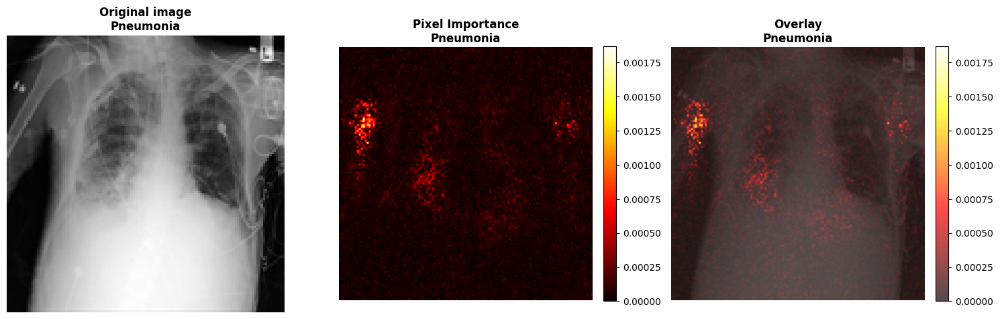

Accuracy: 0.7342, PR_auc: 0.6141


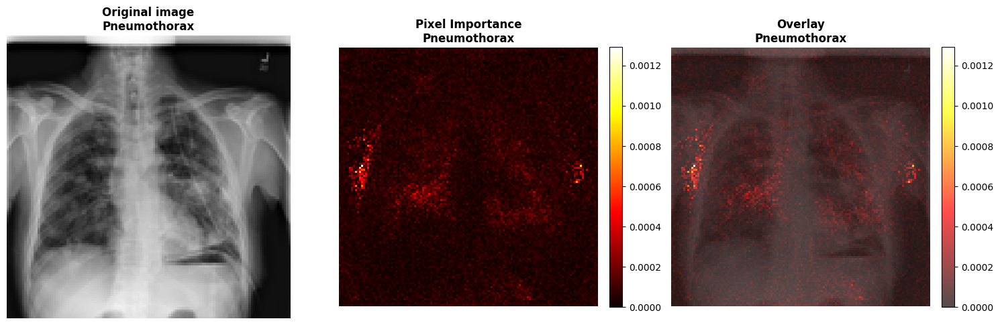

Accuracy: 0.7019, PR_auc: 0.7797


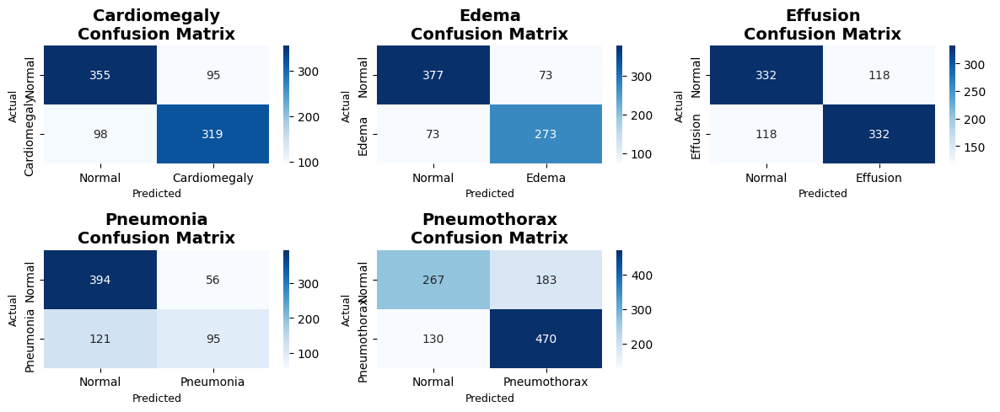

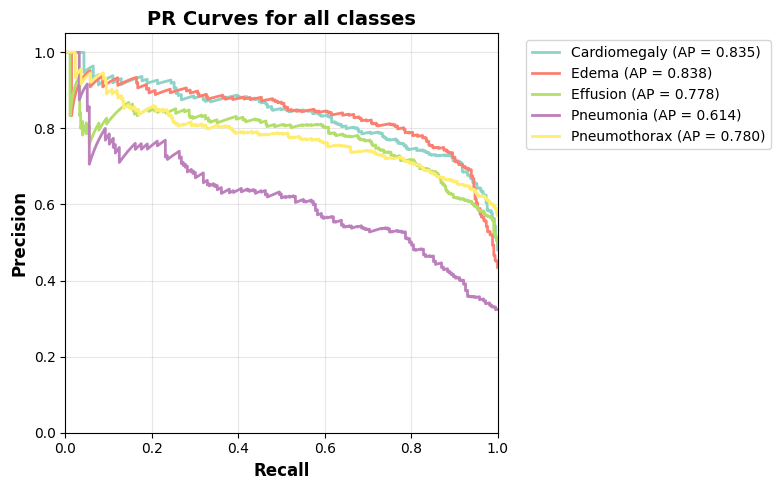

Disease              Accuracy   Precision  Recall     F1         ROC_AUC    PR-AUC    
--------------------------------------------------------------------------------
Cardiomegaly         0.7774     0.7705     0.7650     0.7677     0.8619     0.8349    
Edema                0.8166     0.7890     0.7890     0.7890     0.8868     0.8376    
Effusion             0.7378     0.7378     0.7378     0.7378     0.8074     0.7775    
Pneumonia            0.7342     0.6291     0.4398     0.5177     0.7650     0.6141    
Pneumothorax         0.7019     0.7198     0.7833     0.7502     0.7453     0.7797    
Average              0.7536     0.7292     0.7030     0.7125     0.8133     0.7688    


In [ ]:
image_size = (128, 128)
X_test, y_test, _ = load_dataset("test", image_size)
models_path = "/kaggle/input/randomforest_xray/scikitlearn/default/3/randomforest_models.pkl"
test_results = test_models(models_path, X_test, y_test, image_size)

if test_results:
    print(f"{'Disease':<20} {'Accuracy':<10} {'Precision':<10} {'Recall':<10} {'F1':<10} {'ROC_AUC':<10} {'PR-AUC':<10}")
    print("-" * 80)

    for disease, metrics in test_results.items():
        print(f"{disease:<20} {metrics['accuracy']:<10.4f} {metrics['precision']:<10.4f} "
              f"{metrics['recall']:<10.4f} {metrics['f1']:<10.4f} {metrics['auc']:<10.4f} {metrics['pr_auc']:<10.4f}")

    avg_accuracy = np.mean([metrics['accuracy'] for metrics in test_results.values()])
    avg_precision = np.mean([metrics['precision'] for metrics in test_results.values()])
    avg_recall = np.mean([metrics['recall'] for metrics in test_results.values()])
    avg_f1 = np.mean([metrics['f1'] for metrics in test_results.values()])
    avg_auc = np.mean([metrics['auc'] for metrics in test_results.values()])
    avg_pr_auc = np.mean([metrics['pr_auc'] for metrics in test_results.values()])

    print(f"{'Average':<20} {avg_accuracy:<10.4f} {avg_precision:<10.4f} "
            f"{avg_recall:<10.4f} {avg_f1:<10.4f} {avg_auc:<10.4f} {avg_pr_auc:<10.4f}")

# Model 2: Simple CNN

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
from tqdm import tqdm
from sklearn.metrics import precision_recall_curve, auc
import warnings
warnings.filterwarnings('ignore')

DATA_DIR = path
BATCH_SIZE = 16
EPOCHS = 15
LEARNING_RATE = 0.0001
IMG_SIZE = 448

PATHOLOGIES = [d for d in os.listdir(os.path.join(DATA_DIR, 'train')) if d != 'Normal' and os.path.isdir(os.path.join(DATA_DIR, 'train', d))]

In [ ]:
train_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

val_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

In [ ]:
class BinaryChestXRayDataset(Dataset):
    def __init__(self, data_dir, target_class, transform=None, return_paths=False):
        self.data_dir = data_dir
        self.transform = transform
        self.target_class = target_class
        self.return_paths = return_paths
        self.images, self.labels, self.image_paths = [], [], []

        for cls_name in [target_class, 'Normal']:
            cls_dir = os.path.join(data_dir, cls_name)
            if os.path.exists(cls_dir):
                for img_name in os.listdir(cls_dir):
                    if img_name.lower().endswith(('.png','.jpg','.jpeg')):
                        self.images.append(os.path.join(cls_dir, img_name))
                        self.labels.append(1 if cls_name == target_class else 0)
                        self.image_paths.append(os.path.join(cls_dir, img_name))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(img_path).convert('L')

        if self.transform:
            image = self.transform(image)

        if self.return_paths:
            return image, label, img_path
        else:
            return image, label

In [ ]:
class SimpleCNN(nn.Module):
    def __init__(self, num_classes=2):
        super(SimpleCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=5, padding=2),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),

            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.AdaptiveAvgPool2d((8, 8)),
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.4),
            nn.Linear(256 * 8 * 8, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, 128),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

In [ ]:
def get_class_weights(labels):
    labels_np = np.array(labels)
    class_counts = np.bincount(labels_np)
    total_samples = len(labels_np)
    weights = total_samples / (len(class_counts) * class_counts)
    weights = torch.tensor(weights, dtype=torch.float)
    print(f"Class weights: {weights} (counts: {class_counts})")
    return weights

def calculate_pr_auc(model, loader, device):
    model.eval()
    all_probs, all_labels = [], []

    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)[:, 1]
            all_probs.extend(probs.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    precision, recall, _ = precision_recall_curve(all_labels, all_probs)
    return auc(recall, precision)

def validate(model, loader, criterion, device):
    model.eval()
    running_loss, correct, total = 0.0, 0, 0

    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_loss = running_loss / len(loader)
    accuracy = 100 * correct / total
    pr_auc = calculate_pr_auc(model, loader, device)

    return avg_loss, accuracy, pr_auc

def plot_metrics(train_losses, val_losses, val_accuracies, val_pr_aucs, target_class):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(15, 4))

    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_losses, 'b-', label='Train Loss', linewidth=2)
    plt.plot(epochs, val_losses, 'r-', label='Val Loss', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{target_class} - Loss')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 3, 2)
    plt.plot(epochs, val_accuracies, 'g-', label='Val Accuracy', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy (%)')
    plt.title(f'{target_class} - Accuracy')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 3, 3)
    plt.plot(epochs, val_pr_aucs, 'm-', label='Val PR-AUC', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('PR-AUC')
    plt.title(f'{target_class} - PR-AUC')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.savefig(f'{target_class}_metrics.png', dpi=300, bbox_inches='tight')
    plt.show()

Model training

In [ ]:
def train_model(target_class):
    print()
    print(f"Training: {target_class} vs Normal")

    train_dataset = BinaryChestXRayDataset(os.path.join(DATA_DIR, 'train'), target_class, train_transform)
    val_dataset = BinaryChestXRayDataset(os.path.join(DATA_DIR, 'val'), target_class, val_transform)

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

    print(f"Train: {len(train_dataset)} samples")
    print(f"Val: {len(val_dataset)} samples")

    class_weights = get_class_weights(train_dataset.labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = SimpleCNN(num_classes=2).to(device)
    criterion = nn.CrossEntropyLoss(weight=class_weights.to(device))
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

    train_losses, val_losses, val_accuracies, val_pr_aucs = [], [], [], []
    best_model_state = None
    best_metrics = {'val_pr_auc': 0}

    for epoch in range(EPOCHS):
        model.train()
        running_loss = 0.0

        for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

        avg_train_loss = running_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        val_loss, val_acc, val_pr_auc = validate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_pr_aucs.append(val_pr_auc)

        print(f"Epoch {epoch+1}:")
        print(f"  Train Loss: {avg_train_loss:.4f}")
        print(f"  Val Loss: {val_loss:.4f}, Acc: {val_acc:.2f}%, PR-AUC: {val_pr_auc:.4f}")

        if val_pr_auc > best_metrics['val_pr_auc']:
            best_model_state = model.state_dict().copy()
            best_metrics = {
                'epoch': epoch,
                'val_loss': val_loss,
                'val_accuracy': val_acc,
                'val_pr_auc': val_pr_auc
            }
            print("Best model saved.")

    plot_metrics(train_losses, val_losses, val_accuracies, val_pr_aucs, target_class)
    return best_model_state, best_metrics


Training: Pneumonia vs Normal
Train: 3101 samples
Val: 664 samples
Class weights: tensor([0.7383, 1.5490]) (counts: [2100 1001])


Epoch 1/15: 100%|██████████| 194/194 [01:12<00:00,  2.68it/s]


Epoch 1:
  Train Loss: 0.6741
  Val Loss: 0.6626, Acc: 62.35%, PR-AUC: 0.5198
Best model saved.


Epoch 2/15: 100%|██████████| 194/194 [01:10<00:00,  2.73it/s]


Epoch 2:
  Train Loss: 0.6361
  Val Loss: 0.6051, Acc: 70.03%, PR-AUC: 0.5278
Best model saved.


Epoch 3/15: 100%|██████████| 194/194 [01:11<00:00,  2.70it/s]


Epoch 3:
  Train Loss: 0.6319
  Val Loss: 0.6260, Acc: 67.47%, PR-AUC: 0.5383
Best model saved.


Epoch 4/15: 100%|██████████| 194/194 [01:11<00:00,  2.71it/s]


Epoch 4:
  Train Loss: 0.6279
  Val Loss: 0.6115, Acc: 69.73%, PR-AUC: 0.5604
Best model saved.


Epoch 5/15: 100%|██████████| 194/194 [01:11<00:00,  2.72it/s]


Epoch 5:
  Train Loss: 0.6209
  Val Loss: 0.5813, Acc: 71.39%, PR-AUC: 0.5611
Best model saved.


Epoch 6/15: 100%|██████████| 194/194 [01:11<00:00,  2.71it/s]


Epoch 6:
  Train Loss: 0.6135
  Val Loss: 0.5923, Acc: 69.88%, PR-AUC: 0.5675
Best model saved.


Epoch 7/15: 100%|██████████| 194/194 [01:10<00:00,  2.75it/s]


Epoch 7:
  Train Loss: 0.6133
  Val Loss: 0.5783, Acc: 70.18%, PR-AUC: 0.5728
Best model saved.


Epoch 8/15: 100%|██████████| 194/194 [01:10<00:00,  2.75it/s]


Epoch 8:
  Train Loss: 0.6095
  Val Loss: 0.5824, Acc: 69.58%, PR-AUC: 0.5557


Epoch 9/15: 100%|██████████| 194/194 [01:10<00:00,  2.74it/s]


Epoch 9:
  Train Loss: 0.6039
  Val Loss: 0.5857, Acc: 71.08%, PR-AUC: 0.5559


Epoch 10/15: 100%|██████████| 194/194 [01:10<00:00,  2.75it/s]


Epoch 10:
  Train Loss: 0.5995
  Val Loss: 0.6344, Acc: 65.36%, PR-AUC: 0.5686


Epoch 11/15: 100%|██████████| 194/194 [01:10<00:00,  2.75it/s]


Epoch 11:
  Train Loss: 0.5972
  Val Loss: 0.5833, Acc: 69.43%, PR-AUC: 0.5730
Best model saved.


Epoch 12/15: 100%|██████████| 194/194 [01:10<00:00,  2.74it/s]


Epoch 12:
  Train Loss: 0.5985
  Val Loss: 0.6229, Acc: 67.17%, PR-AUC: 0.5578


Epoch 13/15: 100%|██████████| 194/194 [01:10<00:00,  2.74it/s]


Epoch 13:
  Train Loss: 0.6003
  Val Loss: 0.5995, Acc: 68.83%, PR-AUC: 0.5600


Epoch 14/15: 100%|██████████| 194/194 [01:10<00:00,  2.74it/s]


Epoch 14:
  Train Loss: 0.5910
  Val Loss: 0.6627, Acc: 61.60%, PR-AUC: 0.5776
Best model saved.


Epoch 15/15: 100%|██████████| 194/194 [01:11<00:00,  2.73it/s]


Epoch 15:
  Train Loss: 0.5936
  Val Loss: 0.6092, Acc: 68.22%, PR-AUC: 0.5387


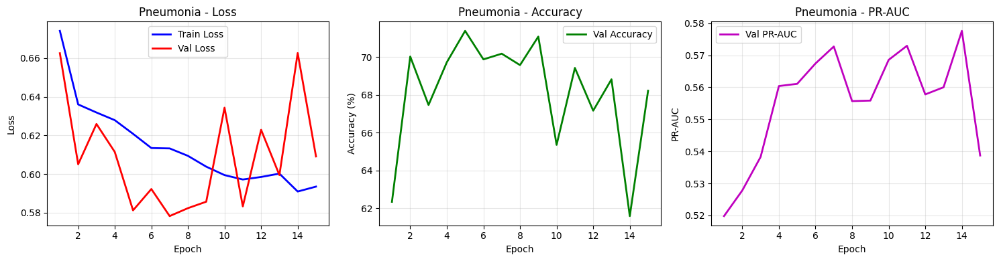


Training: Effusion vs Normal
Train: 4200 samples
Val: 900 samples
Class weights: tensor([1., 1.]) (counts: [2100 2100])


Epoch 1/15: 100%|██████████| 263/263 [01:36<00:00,  2.72it/s]


Epoch 1:
  Train Loss: 0.6099
  Val Loss: 0.5586, Acc: 74.22%, PR-AUC: 0.7700
Best model saved.


Epoch 2/15: 100%|██████████| 263/263 [01:36<00:00,  2.73it/s]


Epoch 2:
  Train Loss: 0.5653
  Val Loss: 0.6410, Acc: 64.22%, PR-AUC: 0.7567


Epoch 3/15: 100%|██████████| 263/263 [01:35<00:00,  2.75it/s]


Epoch 3:
  Train Loss: 0.5546
  Val Loss: 0.5419, Acc: 74.00%, PR-AUC: 0.7914
Best model saved.


Epoch 4/15: 100%|██████████| 263/263 [01:34<00:00,  2.78it/s]


Epoch 4:
  Train Loss: 0.5443
  Val Loss: 0.5443, Acc: 73.56%, PR-AUC: 0.7863


Epoch 5/15: 100%|██████████| 263/263 [01:35<00:00,  2.77it/s]


Epoch 5:
  Train Loss: 0.5414
  Val Loss: 0.5468, Acc: 72.67%, PR-AUC: 0.7976
Best model saved.


Epoch 6/15: 100%|██████████| 263/263 [01:34<00:00,  2.77it/s]


Epoch 6:
  Train Loss: 0.5293
  Val Loss: 0.5225, Acc: 76.78%, PR-AUC: 0.7988
Best model saved.


Epoch 7/15: 100%|██████████| 263/263 [01:35<00:00,  2.76it/s]


Epoch 7:
  Train Loss: 0.5220
  Val Loss: 0.5276, Acc: 74.44%, PR-AUC: 0.7954


Epoch 8/15: 100%|██████████| 263/263 [01:34<00:00,  2.77it/s]


Epoch 8:
  Train Loss: 0.5171
  Val Loss: 0.5270, Acc: 74.89%, PR-AUC: 0.8024
Best model saved.


Epoch 9/15: 100%|██████████| 263/263 [01:35<00:00,  2.75it/s]


Epoch 9:
  Train Loss: 0.5103
  Val Loss: 0.5099, Acc: 75.89%, PR-AUC: 0.8126
Best model saved.


Epoch 10/15: 100%|██████████| 263/263 [01:35<00:00,  2.74it/s]


Epoch 10:
  Train Loss: 0.5046
  Val Loss: 0.4995, Acc: 76.78%, PR-AUC: 0.8175
Best model saved.


Epoch 11/15: 100%|██████████| 263/263 [01:35<00:00,  2.76it/s]


Epoch 11:
  Train Loss: 0.4922
  Val Loss: 0.5061, Acc: 75.89%, PR-AUC: 0.8112


Epoch 12/15: 100%|██████████| 263/263 [01:35<00:00,  2.75it/s]


Epoch 12:
  Train Loss: 0.4944
  Val Loss: 0.5086, Acc: 75.11%, PR-AUC: 0.8193
Best model saved.


Epoch 13/15: 100%|██████████| 263/263 [01:34<00:00,  2.77it/s]


Epoch 13:
  Train Loss: 0.4833
  Val Loss: 0.4938, Acc: 77.33%, PR-AUC: 0.8264
Best model saved.


Epoch 14/15: 100%|██████████| 263/263 [01:36<00:00,  2.73it/s]


Epoch 14:
  Train Loss: 0.4835
  Val Loss: 0.5336, Acc: 73.44%, PR-AUC: 0.8143


Epoch 15/15: 100%|██████████| 263/263 [01:36<00:00,  2.74it/s]


Epoch 15:
  Train Loss: 0.4786
  Val Loss: 0.5048, Acc: 77.33%, PR-AUC: 0.8268
Best model saved.


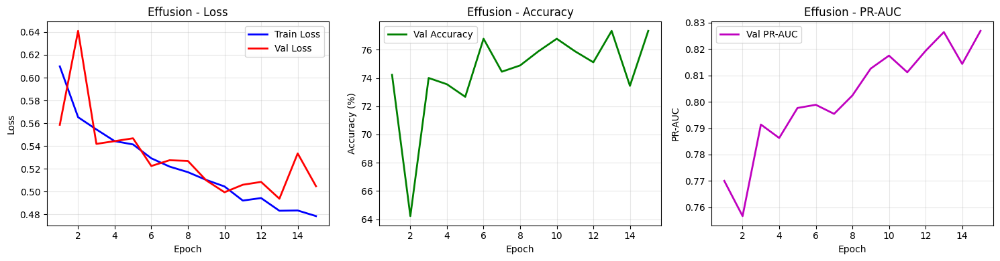


Training: Cardiomegaly vs Normal
Train: 4043 samples
Val: 866 samples
Class weights: tensor([0.9626, 1.0404]) (counts: [2100 1943])


Epoch 1/15: 100%|██████████| 253/253 [01:32<00:00,  2.72it/s]


Epoch 1:
  Train Loss: 0.6301
  Val Loss: 0.5854, Acc: 68.82%, PR-AUC: 0.7093
Best model saved.


Epoch 2/15: 100%|██████████| 253/253 [01:30<00:00,  2.79it/s]


Epoch 2:
  Train Loss: 0.5935
  Val Loss: 0.5588, Acc: 70.21%, PR-AUC: 0.7305
Best model saved.


Epoch 3/15: 100%|██████████| 253/253 [01:30<00:00,  2.79it/s]


Epoch 3:
  Train Loss: 0.5643
  Val Loss: 0.5490, Acc: 71.71%, PR-AUC: 0.7645
Best model saved.


Epoch 4/15: 100%|██████████| 253/253 [01:30<00:00,  2.78it/s]


Epoch 4:
  Train Loss: 0.5583
  Val Loss: 0.5570, Acc: 71.36%, PR-AUC: 0.7730
Best model saved.


Epoch 5/15: 100%|██████████| 253/253 [01:30<00:00,  2.79it/s]


Epoch 5:
  Train Loss: 0.5372
  Val Loss: 0.5275, Acc: 73.21%, PR-AUC: 0.7827
Best model saved.


Epoch 6/15: 100%|██████████| 253/253 [01:31<00:00,  2.77it/s]


Epoch 6:
  Train Loss: 0.5332
  Val Loss: 0.5052, Acc: 75.29%, PR-AUC: 0.7964
Best model saved.


Epoch 7/15: 100%|██████████| 253/253 [01:32<00:00,  2.74it/s]


Epoch 7:
  Train Loss: 0.5224
  Val Loss: 0.4923, Acc: 76.33%, PR-AUC: 0.8123
Best model saved.


Epoch 8/15: 100%|██████████| 253/253 [01:33<00:00,  2.70it/s]


Epoch 8:
  Train Loss: 0.5130
  Val Loss: 0.4838, Acc: 75.52%, PR-AUC: 0.8183
Best model saved.


Epoch 9/15: 100%|██████████| 253/253 [01:34<00:00,  2.67it/s]


Epoch 9:
  Train Loss: 0.5111
  Val Loss: 0.4979, Acc: 74.36%, PR-AUC: 0.8235
Best model saved.


Epoch 10/15: 100%|██████████| 253/253 [01:33<00:00,  2.71it/s]


Epoch 10:
  Train Loss: 0.5044
  Val Loss: 0.4822, Acc: 76.44%, PR-AUC: 0.8377
Best model saved.


Epoch 11/15: 100%|██████████| 253/253 [01:33<00:00,  2.70it/s]


Epoch 11:
  Train Loss: 0.4915
  Val Loss: 0.4770, Acc: 75.52%, PR-AUC: 0.8340


Epoch 12/15: 100%|██████████| 253/253 [01:33<00:00,  2.72it/s]


Epoch 12:
  Train Loss: 0.4935
  Val Loss: 0.4733, Acc: 76.79%, PR-AUC: 0.8401
Best model saved.


Epoch 13/15: 100%|██████████| 253/253 [01:33<00:00,  2.72it/s]


Epoch 13:
  Train Loss: 0.4832
  Val Loss: 0.4704, Acc: 76.21%, PR-AUC: 0.8386


Epoch 14/15: 100%|██████████| 253/253 [01:33<00:00,  2.70it/s]


Epoch 14:
  Train Loss: 0.4834
  Val Loss: 0.5004, Acc: 75.06%, PR-AUC: 0.8399


Epoch 15/15: 100%|██████████| 253/253 [01:33<00:00,  2.69it/s]


Epoch 15:
  Train Loss: 0.4787
  Val Loss: 0.4525, Acc: 77.48%, PR-AUC: 0.8509
Best model saved.


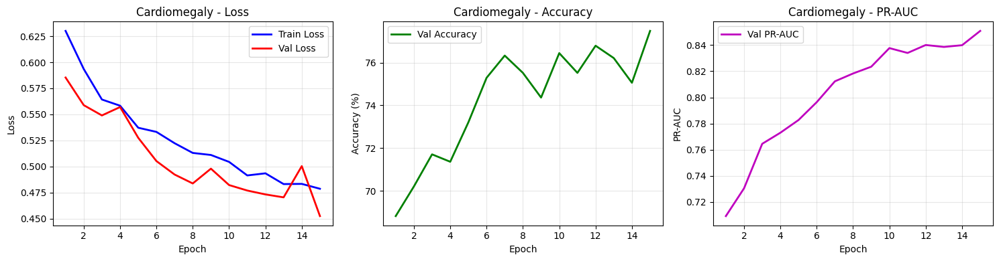


Training: Edema vs Normal
Train: 3712 samples
Val: 795 samples
Class weights: tensor([0.8838, 1.1514]) (counts: [2100 1612])


Epoch 1/15: 100%|██████████| 232/232 [01:27<00:00,  2.66it/s]


Epoch 1:
  Train Loss: 0.5315
  Val Loss: 0.4924, Acc: 77.11%, PR-AUC: 0.8041
Best model saved.


Epoch 2/15: 100%|██████████| 232/232 [01:25<00:00,  2.72it/s]


Epoch 2:
  Train Loss: 0.4838
  Val Loss: 0.4669, Acc: 77.36%, PR-AUC: 0.8183
Best model saved.


Epoch 3/15: 100%|██████████| 232/232 [01:24<00:00,  2.74it/s]


Epoch 3:
  Train Loss: 0.4651
  Val Loss: 0.4374, Acc: 80.88%, PR-AUC: 0.8326
Best model saved.


Epoch 4/15: 100%|██████████| 232/232 [01:24<00:00,  2.75it/s]


Epoch 4:
  Train Loss: 0.4553
  Val Loss: 0.4345, Acc: 80.00%, PR-AUC: 0.8319


Epoch 5/15: 100%|██████████| 232/232 [01:26<00:00,  2.69it/s]


Epoch 5:
  Train Loss: 0.4472
  Val Loss: 0.4519, Acc: 79.50%, PR-AUC: 0.8411
Best model saved.


Epoch 6/15: 100%|██████████| 232/232 [01:25<00:00,  2.71it/s]


Epoch 6:
  Train Loss: 0.4344
  Val Loss: 0.4152, Acc: 83.40%, PR-AUC: 0.8436
Best model saved.


Epoch 7/15: 100%|██████████| 232/232 [01:24<00:00,  2.75it/s]


Epoch 7:
  Train Loss: 0.4284
  Val Loss: 0.4209, Acc: 82.26%, PR-AUC: 0.8457
Best model saved.


Epoch 8/15: 100%|██████████| 232/232 [01:24<00:00,  2.75it/s]


Epoch 8:
  Train Loss: 0.4209
  Val Loss: 0.4283, Acc: 81.64%, PR-AUC: 0.8509
Best model saved.


Epoch 9/15: 100%|██████████| 232/232 [01:25<00:00,  2.73it/s]


Epoch 9:
  Train Loss: 0.4200
  Val Loss: 0.4215, Acc: 81.38%, PR-AUC: 0.8541
Best model saved.


Epoch 10/15: 100%|██████████| 232/232 [01:25<00:00,  2.73it/s]


Epoch 10:
  Train Loss: 0.4117
  Val Loss: 0.4262, Acc: 80.63%, PR-AUC: 0.8654
Best model saved.


Epoch 11/15: 100%|██████████| 232/232 [01:24<00:00,  2.74it/s]


Epoch 11:
  Train Loss: 0.4057
  Val Loss: 0.4323, Acc: 81.13%, PR-AUC: 0.8553


Epoch 12/15: 100%|██████████| 232/232 [01:24<00:00,  2.73it/s]


Epoch 12:
  Train Loss: 0.4040
  Val Loss: 0.4054, Acc: 82.52%, PR-AUC: 0.8595


Epoch 13/15: 100%|██████████| 232/232 [01:24<00:00,  2.75it/s]


Epoch 13:
  Train Loss: 0.4034
  Val Loss: 0.4117, Acc: 82.64%, PR-AUC: 0.8533


Epoch 14/15: 100%|██████████| 232/232 [01:24<00:00,  2.74it/s]


Epoch 14:
  Train Loss: 0.3966
  Val Loss: 0.4136, Acc: 82.77%, PR-AUC: 0.8580


Epoch 15/15: 100%|██████████| 232/232 [01:24<00:00,  2.75it/s]


Epoch 15:
  Train Loss: 0.3942
  Val Loss: 0.4164, Acc: 81.13%, PR-AUC: 0.8532


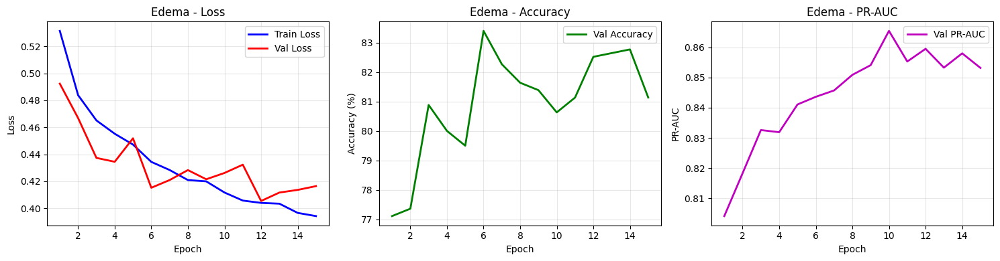


Training: Pneumothorax vs Normal
Train: 4900 samples
Val: 1050 samples
Class weights: tensor([1.1667, 0.8750]) (counts: [2100 2800])


Epoch 1/15: 100%|██████████| 307/307 [01:53<00:00,  2.70it/s]


Epoch 1:
  Train Loss: 0.6817
  Val Loss: 0.6445, Acc: 62.10%, PR-AUC: 0.7248
Best model saved.


Epoch 2/15: 100%|██████████| 307/307 [01:51<00:00,  2.76it/s]


Epoch 2:
  Train Loss: 0.6583
  Val Loss: 0.6412, Acc: 63.24%, PR-AUC: 0.7525
Best model saved.


Epoch 3/15: 100%|██████████| 307/307 [01:51<00:00,  2.76it/s]


Epoch 3:
  Train Loss: 0.6414
  Val Loss: 0.6229, Acc: 65.81%, PR-AUC: 0.7591
Best model saved.


Epoch 4/15: 100%|██████████| 307/307 [01:50<00:00,  2.77it/s]


Epoch 4:
  Train Loss: 0.6291
  Val Loss: 0.6159, Acc: 66.57%, PR-AUC: 0.7711
Best model saved.


Epoch 5/15: 100%|██████████| 307/307 [01:52<00:00,  2.73it/s]


Epoch 5:
  Train Loss: 0.6175
  Val Loss: 0.6009, Acc: 67.43%, PR-AUC: 0.7900
Best model saved.


Epoch 6/15: 100%|██████████| 307/307 [01:50<00:00,  2.77it/s]


Epoch 6:
  Train Loss: 0.5967
  Val Loss: 0.6031, Acc: 65.90%, PR-AUC: 0.8028
Best model saved.


Epoch 7/15: 100%|██████████| 307/307 [01:51<00:00,  2.76it/s]


Epoch 7:
  Train Loss: 0.5967
  Val Loss: 0.5638, Acc: 70.57%, PR-AUC: 0.8289
Best model saved.


Epoch 8/15: 100%|██████████| 307/307 [01:50<00:00,  2.77it/s]


Epoch 8:
  Train Loss: 0.5851
  Val Loss: 0.5670, Acc: 71.33%, PR-AUC: 0.8216


Epoch 9/15: 100%|██████████| 307/307 [01:50<00:00,  2.79it/s]


Epoch 9:
  Train Loss: 0.5744
  Val Loss: 0.5477, Acc: 73.62%, PR-AUC: 0.8454
Best model saved.


Epoch 10/15: 100%|██████████| 307/307 [01:50<00:00,  2.78it/s]


Epoch 10:
  Train Loss: 0.5689
  Val Loss: 0.5479, Acc: 73.24%, PR-AUC: 0.8350


Epoch 11/15: 100%|██████████| 307/307 [01:50<00:00,  2.78it/s]


Epoch 11:
  Train Loss: 0.5576
  Val Loss: 0.5779, Acc: 70.67%, PR-AUC: 0.8372


Epoch 12/15: 100%|██████████| 307/307 [01:51<00:00,  2.75it/s]


Epoch 12:
  Train Loss: 0.5563
  Val Loss: 0.5503, Acc: 71.90%, PR-AUC: 0.8360


Epoch 13/15: 100%|██████████| 307/307 [01:51<00:00,  2.75it/s]


Epoch 13:
  Train Loss: 0.5432
  Val Loss: 0.5280, Acc: 73.90%, PR-AUC: 0.8496
Best model saved.


Epoch 14/15: 100%|██████████| 307/307 [01:51<00:00,  2.76it/s]


Epoch 14:
  Train Loss: 0.5383
  Val Loss: 0.5519, Acc: 71.33%, PR-AUC: 0.8628
Best model saved.


Epoch 15/15: 100%|██████████| 307/307 [01:51<00:00,  2.75it/s]


Epoch 15:
  Train Loss: 0.5274
  Val Loss: 0.5353, Acc: 73.71%, PR-AUC: 0.8553


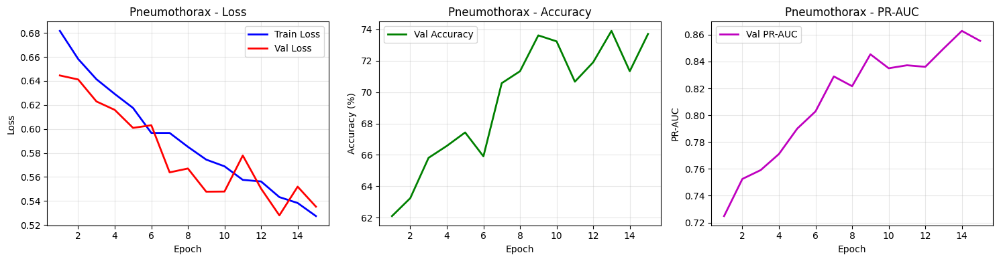


💾 Models saved to 'cnn_models.pt'

Final results:
Pneumonia       | Epoch: 14 | Acc:  61.60% | PR-AUC: 0.5776
Effusion        | Epoch: 15 | Acc:  77.33% | PR-AUC: 0.8268
Cardiomegaly    | Epoch: 15 | Acc:  77.48% | PR-AUC: 0.8509
Edema           | Epoch: 10 | Acc:  80.63% | PR-AUC: 0.8654
Pneumothorax    | Epoch: 14 | Acc:  71.33% | PR-AUC: 0.8628


In [ ]:
    all_models = {}
    all_metrics = {}

    for pathology in PATHOLOGIES:
        model_state, best_metrics = train_model(pathology)
        if model_state is not None:
            all_models[pathology] = model_state
            all_metrics[pathology] = best_metrics

    torch.save(all_models, 'cnn_models.pt')

    print()
    print("Final results:")

    for pathology, metrics in all_metrics.items():
        print(f"{pathology:15} Epoch: {metrics['epoch']+1:2d} | "
              f"Acc: {metrics['val_accuracy']:6.2f}% | "
              f"PR-AUC: {metrics['val_pr_auc']:.4f}")

Testing and evaluating

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 72.1 MB/s eta 0:00:00:00:010:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 4.0 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of mkl-fft to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-random to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-umath to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 88.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.8 MB/s eta 0:00:00

In [ ]:
from sklearn.metrics import precision_recall_curve, auc, roc_auc_score, confusion_matrix, classification_report
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import seaborn as sns

In [ ]:
def test_model(target_class, model, device):
    print()
    print(f"Testing: {target_class} vs Normal")

    test_dataset = BinaryChestXRayDataset(
        os.path.join(DATA_DIR, 'test'),
        target_class,
        test_transform,
        return_paths=True
    )
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
    print(f"Test samples: {len(test_dataset)}")

    model.eval()
    all_probs, all_labels, all_paths = [], [], []

    with torch.no_grad():
        for images, labels, paths in test_loader:
            images = images.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)[:, 1]

            all_probs.extend(probs.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_paths.extend(paths)

    all_probs = np.array(all_probs)
    all_labels = np.array(all_labels)

    precision, recall, thresholds = precision_recall_curve(all_labels, all_probs)
    f1_scores = 2 * precision * recall / (precision + recall + 1e-8)
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds[optimal_idx]

    predictions = (all_probs >= optimal_threshold).astype(int)

    roc_auc = roc_auc_score(all_labels, all_probs)
    pr_auc = auc(recall, precision)
    cm = confusion_matrix(all_labels, predictions)
    tn, fp, fn, tp = cm.ravel()

    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision_score = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall_score = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = f1_scores[optimal_idx]
    specificity = tn / (tn + fp) if (tn + fp) > 0 else 0

    print(f"Optimal threshold: {optimal_threshold:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"PR-AUC: {pr_auc:.4f}")

    plt.figure(figsize=(2, 2))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'{target_class}')
    plt.ylabel('True')
    plt.xlabel('Predicted')
    plt.tight_layout()
    plt.show()

    metrics = {
        'accuracy': accuracy,
        'precision': precision_score,
        'recall': recall_score,
        'f1': f1,
        'specificity': specificity,
        'roc_auc': roc_auc,
        'pr_auc': pr_auc,
        'threshold': optimal_threshold,
        'confusion_matrix': [tn, fp, fn, tp]
    }

    return all_probs, all_labels, all_paths, metrics

In [ ]:
def apply_gradcam(model, target_class, device, test_paths, all_labels, all_probs, optimal_threshold, num_images=5):
    print(f"\nGrad-CAM for {target_class}:")

    predictions = (all_probs >= 0.8).astype(int)
    correct_disease_images = [
        path for path, true_label, pred_label in zip(test_paths, all_labels, predictions)
        if true_label == 1 and pred_label == 1
    ]

    if not correct_disease_images:
        print(f"No correct predictions for {target_class}")
        return

    selected_images = correct_disease_images[:num_images]
    target_layer = [model.features[-2]]
    cam = GradCAM(model=model, target_layers=target_layer)

    for i, img_path in enumerate(selected_images):
            original_image = Image.open(img_path).convert('L')
            input_tensor = test_transform(original_image).unsqueeze(0).to(device)

            targets = [ClassifierOutputTarget(1)]
            grayscale_cam = cam(input_tensor=input_tensor, targets=targets)
            grayscale_cam = grayscale_cam[0, :]

            original_array = np.array(original_image)

            heatmap = Image.fromarray((grayscale_cam * 255).astype(np.uint8))
            heatmap = heatmap.resize(original_image.size, Image.BILINEAR)
            heatmap_array = np.array(heatmap)

            original_rgb = np.stack([original_array] * 3, axis=-1) / 255.0
            heatmap_rgb = plt.cm.jet(heatmap_array / 255.0)[:, :, :3]

            overlay = 0.5 * original_rgb + 0.5 * heatmap_rgb
            overlay = np.clip(overlay, 0, 1)

            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))
            ax1.imshow(original_image, cmap='gray')
            ax1.set_title(f'Original \n{os.path.basename(img_path)}')
            ax1.axis('off')

            ax2.imshow(heatmap_array, cmap='jet')
            ax2.set_title('Grad-CAM Heatmap')
            ax2.axis('off')

            ax3.imshow(overlay)
            ax3.set_title('Overlay')
            ax3.axis('off')

            plt.tight_layout()
            plt.show()

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
all_models = torch.load('/kaggle/input/cnn-models-xray/pytorch/default/1/cnn_models.pt', map_location=device)

all_metrics = {}
all_pr_curves = {}

for pathology in PATHOLOGIES:
    if pathology in all_models:
        model = SimpleCNN(num_classes=2).to(device)
        model.load_state_dict(all_models[pathology])

        probs, labels, paths, metrics = test_model(pathology, model, device)
        all_metrics[pathology] = metrics

        precision, recall, _ = precision_recall_curve(labels, probs)
        all_pr_curves[pathology] = (precision, recall)

        apply_gradcam(model, pathology, device, paths, labels, probs, metrics['threshold'], num_images=5)

plt.figure(figsize=(8, 6))
for pathology, (precision, recall) in all_pr_curves.items():
    pr_auc = all_metrics[pathology]["pr_auc"]
    plt.plot(recall, precision, label=f'{pathology} (AUC: {pr_auc:.3f})', linewidth=2)

plt.xlabel('Recall', fontsize=12)
plt.ylabel('Precision', fontsize=12)
plt.title('PR Curves', fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.tight_layout()
plt.savefig('all_models_pr_curves.png', dpi=300, bbox_inches='tight')
plt.show()

print()
print("Final test results:")
print(f"{'Disease':<20} {'Accuracy':<10} {'Precision':<10} {'Recall':<10} {'F1':<10} {'ROC-AUC':<10} {'PR-AUC':<10}")
print("-" * 80)

all_accuracies = []
all_precisions = []
all_recalls = []
all_f1_scores = []
all_roc_aucs = []
all_pr_aucs = []

for pathology, metrics in all_metrics.items():
    print(f"{pathology:<20} {metrics['accuracy']:>10.4f} {metrics['precision']:>10.4f} "
          f"{metrics['recall']:>10.4f} {metrics['f1']:>10.4f} {metrics['roc_auc']:>10.4f} {metrics['pr_auc']:>10.4f}")

    all_accuracies.append(metrics['accuracy'])
    all_precisions.append(metrics['precision'])
    all_recalls.append(metrics['recall'])
    all_f1_scores.append(metrics['f1'])
    all_roc_aucs.append(metrics['roc_auc'])
    all_pr_aucs.append(metrics['pr_auc'])

if all_accuracies:
    print(f"{'Average':<20} {np.mean(all_accuracies):>10.4f} {np.mean(all_precisions):>10.4f} "
          f"{np.mean(all_recalls):>10.4f} {np.mean(all_f1_scores):>10.4f} {np.mean(all_roc_aucs):>10.4f} {np.mean(all_pr_aucs):>10.4f}")


# Model 3: Resnet

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, models
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
from tqdm import tqdm
from pathlib import Path
from sklearn.metrics import precision_recall_curve, auc
import warnings
warnings.filterwarnings('ignore')

DATA_DIR = path
BATCH_SIZE = 16
EPOCHS = 10
LEARNING_RATE = 0.00001
IMG_SIZE = 448

PATHOLOGIES = [d for d in os.listdir(os.path.join(DATA_DIR, 'train')) if d != 'Normal' and os.path.isdir(os.path.join(DATA_DIR, 'train', d))]

In [ ]:
MODEL_CONFIGS = {
    'resnet18': {
        'model_class': models.resnet18,
        'feature_dim': 512,
        'classifier_layer': 'fc'
    },
    'densenet121': {
        'model_class': models.densenet121,
        'feature_dim': 1024,
        'classifier_layer': 'classifier'
    },
    'efficientnet_b0': {
        'model_class': models.efficientnet_b0,
        'feature_dim': 1280,
        'classifier_layer': 'classifier'
    }
}

In [ ]:
class BinaryChestXRayDataset(Dataset):
    def __init__(self, data_dir, target_class, transform=None, return_paths=False):
        self.data_dir = data_dir
        self.transform = transform
        self.target_class = target_class
        self.return_paths = return_paths
        self.images, self.labels, self.image_paths = [], [], []

        for cls_name in [target_class, 'Normal']:
            cls_dir = os.path.join(data_dir, cls_name)
            if os.path.exists(cls_dir):
                for img_name in os.listdir(cls_dir):
                    if img_name.lower().endswith(('.png','.jpg','.jpeg')):
                        self.images.append(os.path.join(cls_dir, img_name))
                        self.labels.append(1 if cls_name == target_class else 0)
                        self.image_paths.append(os.path.join(cls_dir, img_name))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        if self.return_paths:
            return image, label, img_path
        else:
            return image, label

In [ ]:
train_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
class UniversalClassifier(nn.Module):
    def __init__(self, model_name, num_classes=2, pretrained=True):
        super(UniversalClassifier, self).__init__()
        self.model_name = model_name

        if model_name not in MODEL_CONFIGS:
            raise ValueError(f"Model {model_name} not supported. Available: {list(MODEL_CONFIGS.keys())}")

        config = MODEL_CONFIGS[model_name]
        self.backbone = config['model_class'](pretrained=pretrained)

        if model_name.startswith('resnet'):
            in_features = self.backbone.fc.in_features
            self.backbone.fc = nn.Sequential(
                nn.Dropout(0.3),
                nn.Linear(in_features, 512),
                nn.ReLU(inplace=True),
                nn.Dropout(0.2),
                nn.Linear(512, num_classes)
            )
        elif model_name.startswith('densenet'):
            in_features = self.backbone.classifier.in_features
            self.backbone.classifier = nn.Sequential(
                nn.Dropout(0.3),
                nn.Linear(in_features, 512),
                nn.ReLU(inplace=True),
                nn.Dropout(0.2),
                nn.Linear(512, num_classes)
            )
        elif model_name.startswith('efficientnet'):
            in_features = self.backbone.classifier[1].in_features
            self.backbone.classifier = nn.Sequential(
                nn.Dropout(0.3),
                nn.Linear(in_features, 512),
                nn.ReLU(inplace=True),
                nn.Dropout(0.2),
                nn.Linear(512, num_classes)
            )

    def forward(self, x):
        return self.backbone(x)

In [ ]:
def get_class_weights(labels):
    labels_np = np.array(labels)
    class_counts = np.bincount(labels_np)
    total_samples = len(labels_np)
    weights = total_samples / (len(class_counts) * class_counts)
    weights = torch.tensor(weights, dtype=torch.float)
    print(f"Class weights: {weights} (counts: {class_counts})")
    return weights

def calculate_pr_auc(model, loader, device):
    model.eval()
    all_probs, all_labels = [], []

    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)[:, 1]
            all_probs.extend(probs.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    precision, recall, _ = precision_recall_curve(all_labels, all_probs)
    return auc(recall, precision)

def validate(model, loader, criterion, device):
    model.eval()
    running_loss, correct, total = 0.0, 0, 0

    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    avg_loss = running_loss / len(loader)
    accuracy = 100 * correct / total
    pr_auc = calculate_pr_auc(model, loader, device)
    return avg_loss, accuracy, pr_auc

def plot_metrics(train_losses, val_losses, val_accuracies, val_pr_aucs, target_class, model_name):
    epochs = range(1, len(train_losses) + 1)
    plt.figure(figsize=(15, 4))

    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_losses, 'b-', label='Train Loss', linewidth=2)
    plt.plot(epochs, val_losses, 'r-', label='Val Loss', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'{model_name.upper()} {target_class} - Loss')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 3, 3)
    plt.plot(epochs, val_pr_aucs, 'm-', label='Val PR-AUC', linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('PR-AUC')
    plt.title(f'{model_name.upper()} {target_class} - PR-AUC')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

In [ ]:
def train_model(target_class, model_name):
    print()
    print(f"Training {model_name.upper()} for: {target_class} vs Normal")

    train_dataset = BinaryChestXRayDataset(os.path.join(DATA_DIR, 'train'), target_class, train_transform)
    val_dataset = BinaryChestXRayDataset(os.path.join(DATA_DIR, 'val'), target_class, val_transform)

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

    print(f"Train: {len(train_dataset)} samples")
    print(f"Val: {len(val_dataset)} samples")

    class_weights = get_class_weights(train_dataset.labels)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model = UniversalClassifier(model_name=model_name, num_classes=2).to(device)

    if model_name.startswith('resnet'):
        for param in model.backbone.layer4.parameters():
            param.requires_grad = True
    elif model_name.startswith('densenet'):
        for param in model.backbone.features.denseblock4.parameters():
            param.requires_grad = True

    criterion = nn.CrossEntropyLoss(weight=class_weights.to(device))
    optimizer = optim.AdamW(model.parameters(), lr=LEARNING_RATE, weight_decay=0.01)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=EPOCHS)

    train_losses, val_losses, val_accuracies, val_pr_aucs = [], [], [], []
    best_model_state = None
    best_metrics = {'val_pr_auc': 0}

    for epoch in range(EPOCHS):
        model.train()
        running_loss = 0.0

        for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

        avg_train_loss = running_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        val_loss, val_acc, val_pr_auc = validate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_pr_aucs.append(val_pr_auc)

        scheduler.step()
        current_lr = scheduler.get_last_lr()[0]

        print(f"Epoch {epoch+1}:")
        print(f"  Train Loss: {avg_train_loss:.4f}, Val Loss: {val_loss:.4f}, Acc: {val_acc:.2f}%, PR-AUC: {val_pr_auc:.4f}")

        if val_pr_auc > best_metrics['val_pr_auc']:
            best_model_state = model.state_dict().copy()
            best_metrics = {
                'epoch': epoch,
                'val_loss': val_loss,
                'val_accuracy': val_acc,
                'val_pr_auc': val_pr_auc
            }
            print(f"Best {model_name} model saved!")
    plot_metrics(train_losses, val_losses, val_accuracies, val_pr_aucs, target_class, model_name)
    return best_model_state, best_metrics

In [ ]:
def model_train_main(model_name):
    if model_name not in MODEL_CONFIGS:
        print(f"Error: Model {model_name} not supported.")
        return

    all_metrics = {}

    for pathology in PATHOLOGIES:
        model_state, metrics = train_model(pathology, model_name)
        all_metrics[pathology] = metrics

        filename = f'{model_name}_{pathology.lower()}_model.pth'
        torch.save({
            'model_state_dict': model_state,
            'pathology': pathology,
            'model_name': model_name,
            'metrics': metrics
        }, filename)

        print(f"Saved: {filename}")
        print(f"Results - Acc: {metrics['val_accuracy']:.2f}%, PR-AUC: {metrics['val_pr_auc']:.4f}")
        torch.save(all_metrics, f'{model_name}_training_metrics.pth')

    print()
    print(f"Training results - {model_name.upper()}")
    for pathology in PATHOLOGIES:
        metrics = all_metrics[pathology]
        print(f"{pathology:20} | Acc: {metrics['val_accuracy']:5.2f}% | PR-AUC: {metrics['val_pr_auc']:.4f}")

In [ ]:
model_train_main('resnet18')

In [ ]:
model_train_main('densenet121')

In [ ]:
model_train_main('efficientnet_b0')

In [ ]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 85.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.5-py3-none-any.whl size=44284 sha256=fecf1915a7684415b44fc3e7182cfc615ceb3d1c98895ead8cfa79c2ce2e7569
  Stored in directory: /root/.cache/pip/wheels/fb/3b/09/2afc520f3d69bc26ae6bd87416759c820a3f7d05c1a077bbf6
Successfully built grad-cam


In [ ]:
from pathlib import Path
from sklearn.metrics import precision_score, f1_score, recall_score, precision_recall_curve, auc, roc_auc_score, confusion_matrix, classification_report
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import pandas as pd
import seaborn as sns

In [ ]:
def safe_load_checkpoint(checkpoint_path, device):
    try:
        checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=False)
        return checkpoint
    except Exception as e:
        try:
            from torch.serialization import safe_globals
            import numpy.core.multiarray

            with safe_globals([numpy.core.multiarray.scalar]):
                checkpoint = torch.load(checkpoint_path, map_location=device, weights_only=True)
            return checkpoint
        except Exception as e2:
            try:
                checkpoint = torch.load(checkpoint_path, map_location=device)
                return checkpoint
            except Exception as e3:
                print(f"Load attempts failed: {e3}")
                return None

def load_model_from_checkpoint(model_name, checkpoint_path, device):
    try:
        checkpoint = safe_load_checkpoint(checkpoint_path, device)
        if checkpoint is None:
            return None

        model = UniversalClassifier(model_name=model_name, num_classes=2, pretrained=False)
        model = model.to(device)

        if isinstance(checkpoint, dict):
            if 'model_state_dict' in checkpoint:
                state_dict = checkpoint['model_state_dict']
            elif 'state_dict' in checkpoint:
                state_dict = checkpoint['state_dict']
            else:
                state_dict_keys = [k for k in checkpoint.keys() if 'state_dict' in k.lower() or 'model' in k.lower()]
                if state_dict_keys:
                    state_dict = checkpoint[state_dict_keys[0]]
                else:
                    state_dict = checkpoint
        else:
            state_dict = checkpoint

        new_state_dict = {}
        if isinstance(state_dict, dict):
            for k, v in state_dict.items():
                name = k[7:] if k.startswith('module.') else k
                new_state_dict[name] = v
        else:
            return None

        model.load_state_dict(new_state_dict, strict=False)
        return model
    except Exception as e:
        return None

def get_target_layers(model, model_name):
    if model_name.startswith('resnet'):
        return [model.backbone.layer4[-1]]
    elif model_name.startswith('densenet'):
        return [model.backbone.features[-1]]
    elif model_name.startswith('efficientnet'):
        return [model.backbone.features[-1]]
    return None

def test_single_model(model, target_class, device, data_dir, model_name):
    print()
    print(f"Testing: {target_class} vs Normal")

    test_dataset = BinaryChestXRayDataset(
        os.path.join(data_dir, 'test'),
        target_class,
        test_transform,
        return_paths=True
    )

    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

    labels = test_dataset.labels
    normal_count = sum(1 for x in labels if x == 0)
    disease_count = sum(1 for x in labels if x == 1)
    print(f"Dataset: {normal_count} Normal, {disease_count} {target_class}")

    model.eval()
    all_probs, all_labels, all_paths = [], [], []
    all_predictions = []

    with torch.no_grad():
        for images, labels, paths in test_loader:
            images = images.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)[:, 1]
            predictions = (probs > 0.5).long()

            all_probs.extend(probs.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_paths.extend(paths)
            all_predictions.extend(predictions.cpu().numpy())

    all_probs = np.array(all_probs)
    all_labels = np.array(all_labels)
    all_predictions = np.array(all_predictions)

    precision, recall, thresholds = precision_recall_curve(all_labels, all_probs)
    f1_scores = 2 * precision * recall / (precision + recall + 1e-8)
    optimal_idx = np.argmax(f1_scores[:-1])
    optimal_threshold = thresholds[optimal_idx]

    optimal_predictions = (all_probs >= optimal_threshold).astype(int)

    roc_auc = roc_auc_score(all_labels, all_probs)
    pr_auc = auc(recall, precision)
    accuracy = np.mean(all_predictions == all_labels)
    precision_val = precision_score(all_labels, all_predictions, average='weighted')
    recall_val = recall_score(all_labels, all_predictions, average='weighted')
    f1 = f1_score(all_labels, all_predictions, average='weighted')

    cm = confusion_matrix(all_labels, all_predictions)

    print(f"   Optimal Threshold: {optimal_threshold:.4f}")
    print(f"   Accuracy:         {accuracy:.4f}")
    print(f"   F1-Score:         {f1:.4f}")
    print(f"   PR-AUC:           {pr_auc:.4f}")

    plt.figure(figsize=(2, 2))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'{target_class}')
    plt.ylabel('True')
    plt.xlabel('Predicted')
    plt.tight_layout()
    plt.show()

    results = {
        'probs': all_probs,
        'labels': all_labels,
        'paths': all_paths,
        'predictions': all_predictions,
        'optimal_threshold': optimal_threshold,
        'roc_auc': roc_auc,
        'pr_auc': pr_auc,
        'accuracy': accuracy,
        'precision': precision_val,
        'recall': recall_val,
        'f1': f1,
        'precision_curve': precision,
        'recall_curve': recall,
        'f1_scores': f1_scores
    }

    return results

In [ ]:
def find_model_files(models_dir):
    model_files = {}
    pathologies_lower = [p.lower() for p in PATHOLOGIES]

    for file_path in Path(models_dir).glob('*.pth'):
        filename = file_path.stem.lower()

        if 'resnet18' in filename:
            model_name = 'resnet18'
        elif 'efficientnet' in filename or 'efficient' in filename:
            model_name = 'efficientnet_b0'
        elif 'densenet' in filename or 'dense' in filename:
            model_name = 'densenet121'
        else:
            continue

        pathology = None
        for i, patho_lower in enumerate(pathologies_lower):
            if patho_lower in filename:
                pathology = PATHOLOGIES[i]
                break

        if model_name not in model_files:
            model_files[model_name] = {}

        model_files[model_name][pathology] = str(file_path)
    return model_files

In [ ]:
def apply_gradcam_visualization(model, model_name, target_class, results, device, num_images=3):
    confidence_threshold=0.8
    print(f"\nGrad-CAM Visualization for {model_name} - {target_class}")

    target_layers = get_target_layers(model, model_name)
    if target_layers is None:
        return

    cam = GradCAM(model=model, target_layers=target_layers)

    paths = results['paths']
    labels = results['labels']
    predictions = results['predictions']

    if 'probabilities' not in results:
        probabilities = [1.0] * len(predictions)
    else:
        probabilities = results['probabilities']

    true_positives = []

    for i, (path, true_label, pred, prob) in enumerate(zip(paths, labels, predictions, probabilities)):
        if true_label == 1 and pred == 1 and prob >= confidence_threshold:
            true_positives.append((i, prob))

    true_positives.sort(key=lambda x: x[1], reverse=True)
    if not true_positives:
        return

    for i, (idx, confidence) in enumerate(true_positives[:num_images]):
        try:
            img_path = paths[idx]
            original_image = Image.open(img_path).convert('RGB')

            input_tensor = test_transform(original_image).unsqueeze(0).to(device)

            targets = [ClassifierOutputTarget(1)]
            grayscale_cam = cam(input_tensor=input_tensor, targets=targets)
            grayscale_cam = grayscale_cam[0, :]

            rgb_img = np.array(original_image.resize((IMG_SIZE, IMG_SIZE))) / 255.0
            visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)

            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

            ax1.imshow(original_image)
            ax1.set_title(f'Original\n{target_class}\nConfidence: {confidence:.3f}')
            ax1.axis('off')

            ax2.imshow(grayscale_cam, cmap='jet')
            ax2.set_title('Grad-CAM Heatmap')
            ax2.axis('off')

            ax3.imshow(visualization)
            ax3.set_title('Overlay')
            ax3.axis('off')

            plt.tight_layout()
            plt.show()
        except Exception as e:
            continue

In [ ]:
def create_summary_pr_curves(all_results, output_dir):
    plt.figure(figsize=(9, 5))

    for model_name, pathologies in all_results.items():
        for pathology, results in pathologies.items():
            precision = results['precision_curve']
            recall = results['recall_curve']
            pr_auc = results['pr_auc']

            plt.plot(
                recall, precision,
                label=f'{model_name} - {pathology} (AUC={pr_auc:.3f})',
                linewidth=2, alpha=0.8
            )

    plt.xlabel('Recall', fontsize=12)
    plt.ylabel('Precision', fontsize=12)
    plt.title('PR Curves')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=9)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    os.makedirs(output_dir, exist_ok=True)
    output_path = os.path.join(output_dir, 'all_models_pr_curves.png')
    plt.savefig(output_path, dpi=300, bbox_inches='tight')
    plt.show()

In [ ]:
def main_testing(models_dir, data_dir, output_dir='results'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    os.makedirs(output_dir, exist_ok=True)
    model_files = find_model_files(models_dir)

    all_results = {}
    summary_data = []

    available_pathologies = set()
    for model_name, pathologies in model_files.items():
        for pathology in pathologies.keys():
            if pathology in PATHOLOGIES:
                available_pathologies.add(pathology)

    for model_name, pathologies in model_files.items():
        all_results[model_name] = {}

        for pathology, model_path in pathologies.items():
            model = load_model_from_checkpoint(model_name, model_path, device)
            if model is None:
                print(f"Failed to load model for {pathology}")
                continue

            results = test_single_model(model, pathology, device, data_dir, model_name)
            if results is not None:
                all_results[model_name][pathology] = results

                summary_data.append({
                    'Model': model_name,
                    'Pathology': pathology,
                    'ROC-AUC': results['roc_auc'],
                    'PR-AUC': results['pr_auc'],
                    'Accuracy': results['accuracy'],
                    'Precision': results['precision'],
                    'Recall': results['recall'],
                    'F1-Score': results['f1']
                })

                apply_gradcam_visualization(model, model_name, pathology, results, device, num_images=5)
            else:
                print(f"Testing failed for {pathology}")

    create_summary_pr_curves(all_results, output_dir)

    if summary_data:
        summary_df = pd.DataFrame(summary_data)

        print()
        print("Final test results:")
        print(f"{'Disease':<20} {'Accuracy':<10} {'Precision':<10} {'Recall':<10} {'F1':<10} {'ROC-AUC':<10} {'PR-AUC':<10}")
        print("-" * 80)

        for _, row in summary_df.iterrows():
            print(f"{row['Pathology']:<20} {row['Accuracy']:<10.4f} {row['Precision']:<10.4f} "
                  f"{row['Recall']:<10.4f} {row['F1-Score']:<10.4f} {row['ROC-AUC']:<10.4f} {row['PR-AUC']:<10.4f}")

        all_accuracies = summary_df['Accuracy'].tolist()
        all_precisions = summary_df['Precision'].tolist()
        all_recalls = summary_df['Recall'].tolist()
        all_f1_scores = summary_df['F1-Score'].tolist()
        all_roc_aucs = summary_df['ROC-AUC'].tolist()
        all_pr_aucs = summary_df['PR-AUC'].tolist()

        print(f"{'Average':<20} {np.mean(all_accuracies):<10.4f} {np.mean(all_precisions):<10.4f} "
              f"{np.mean(all_recalls):<10.4f} {np.mean(all_f1_scores):<10.4f} {np.mean(all_roc_aucs):<10.4f} {np.mean(all_pr_aucs):<10.4f}")

Using device: cuda

Testing: Pneumonia vs Normal
Dataset: 450 Normal, 216 Pneumonia
   Optimal Threshold: 0.4913
   Accuracy:         0.7613
   F1-Score:         0.7662
   PR-AUC:           0.6763


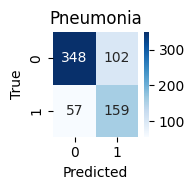


Grad-CAM Visualization for resnet18 - Pneumonia


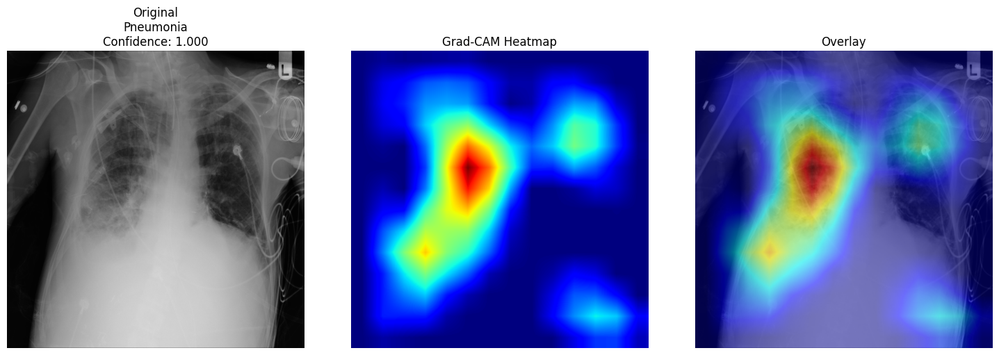

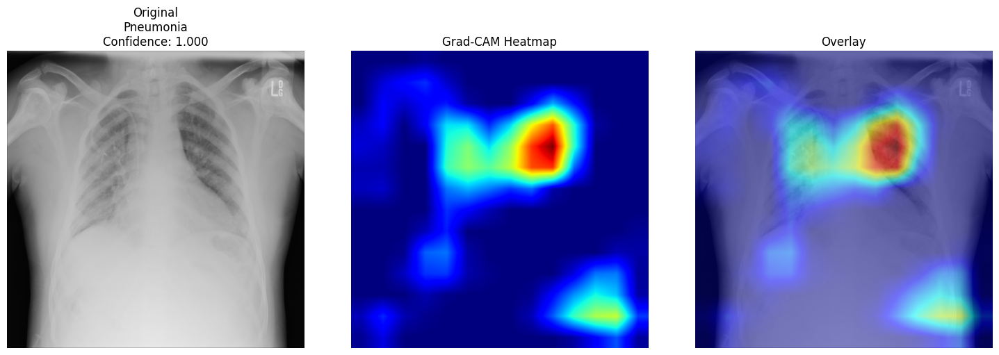

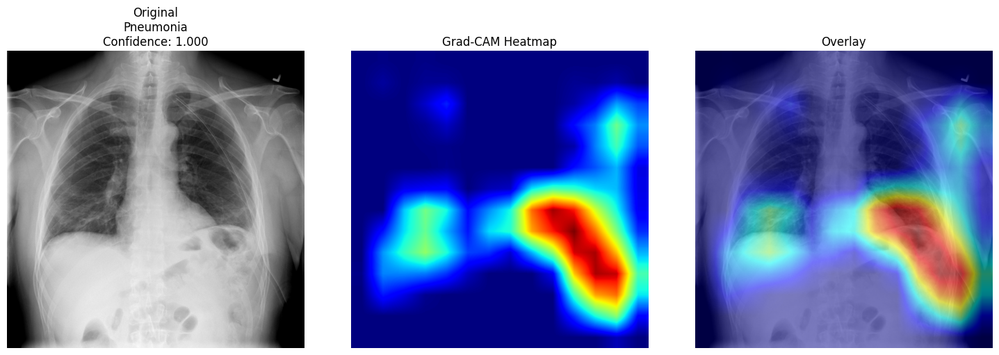

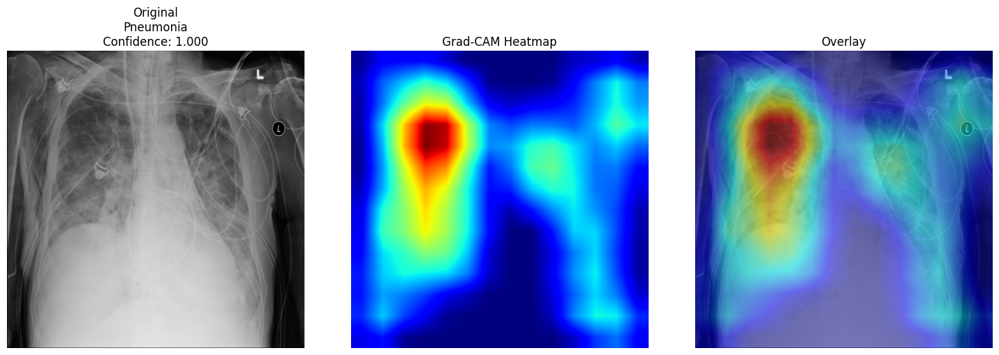

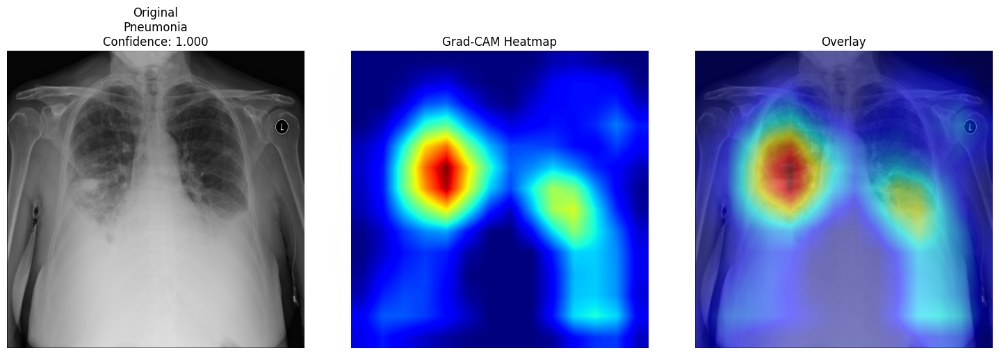


Testing: Effusion vs Normal
Dataset: 450 Normal, 450 Effusion
   Optimal Threshold: 0.1932
   Accuracy:         0.8011
   F1-Score:         0.8004
   PR-AUC:           0.8661


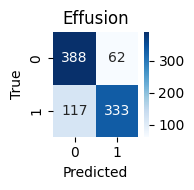


Grad-CAM Visualization for resnet18 - Effusion


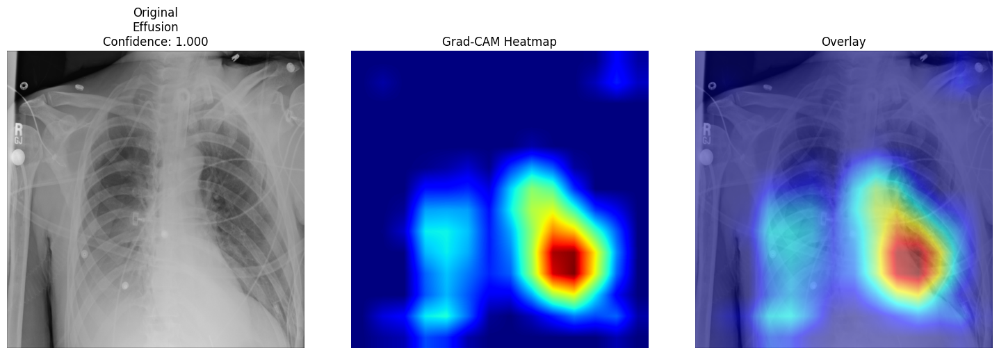

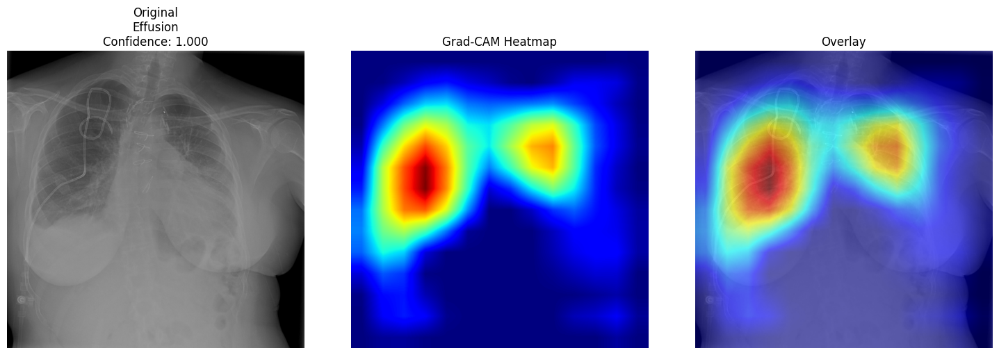

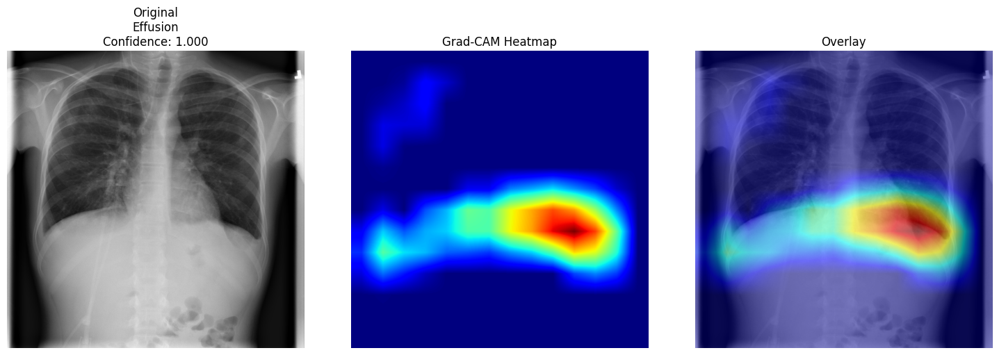

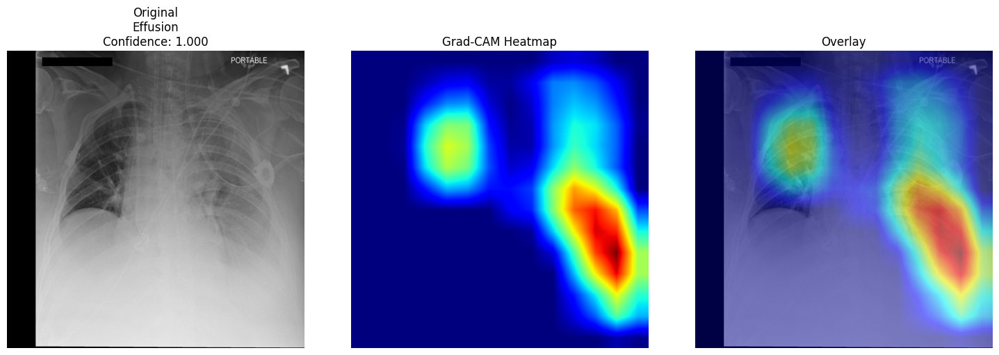

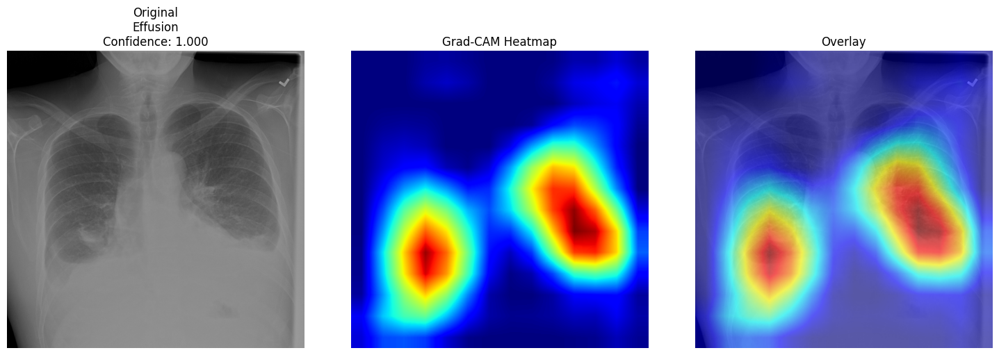


Testing: Pneumothorax vs Normal
Dataset: 450 Normal, 600 Pneumothorax
   Optimal Threshold: 0.2034
   Accuracy:         0.8076
   F1-Score:         0.8086
   PR-AUC:           0.9044


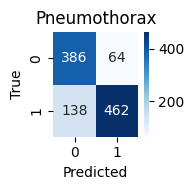


Grad-CAM Visualization for resnet18 - Pneumothorax


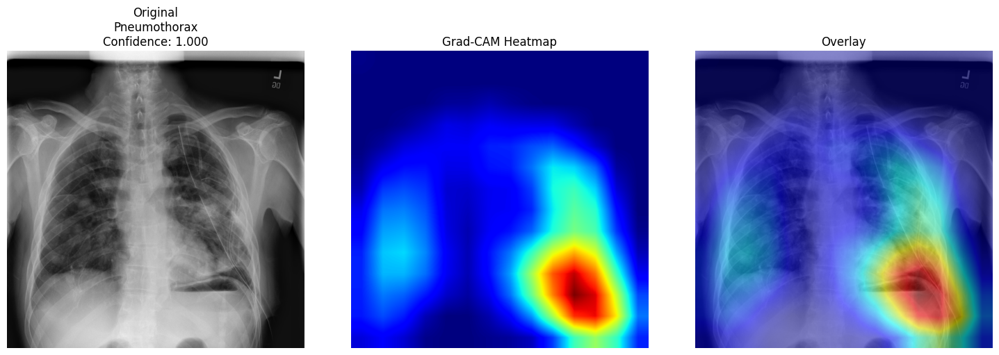

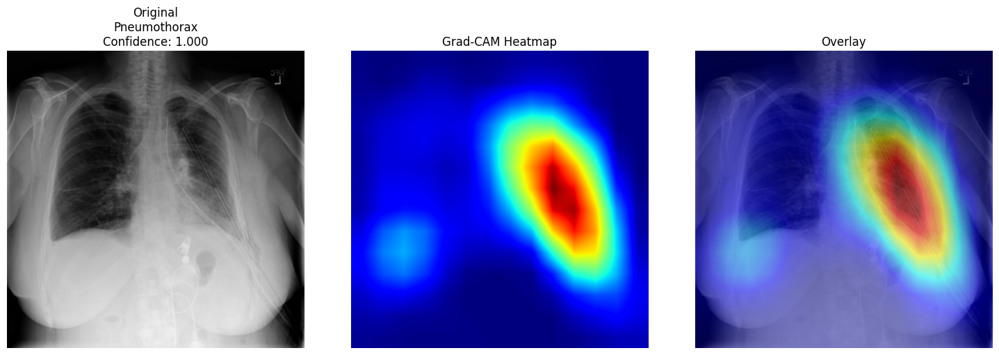

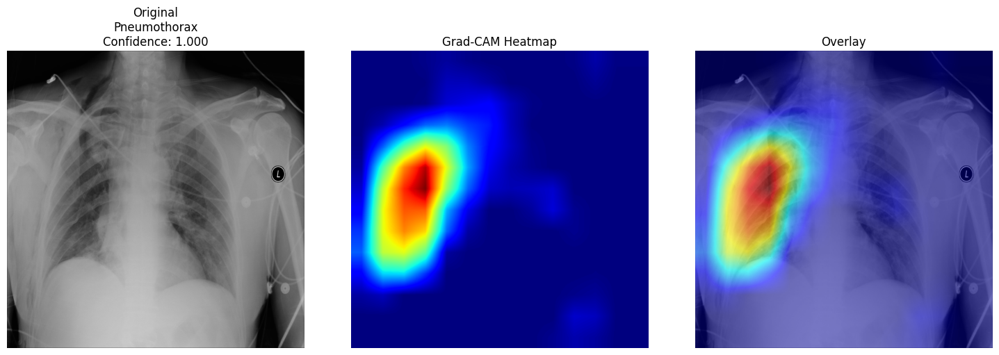

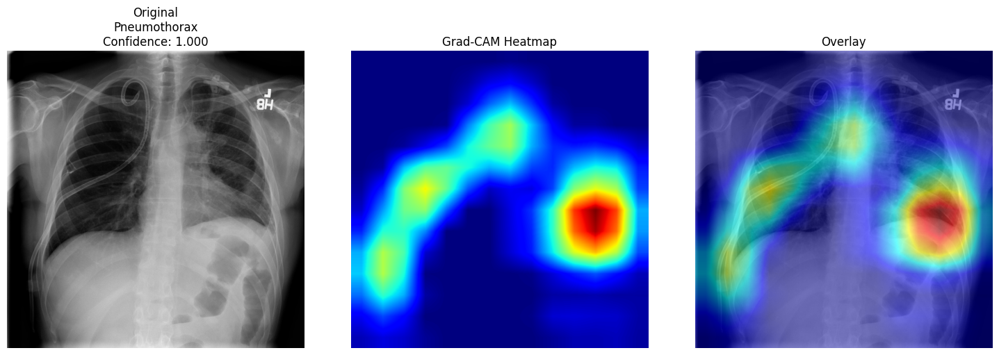

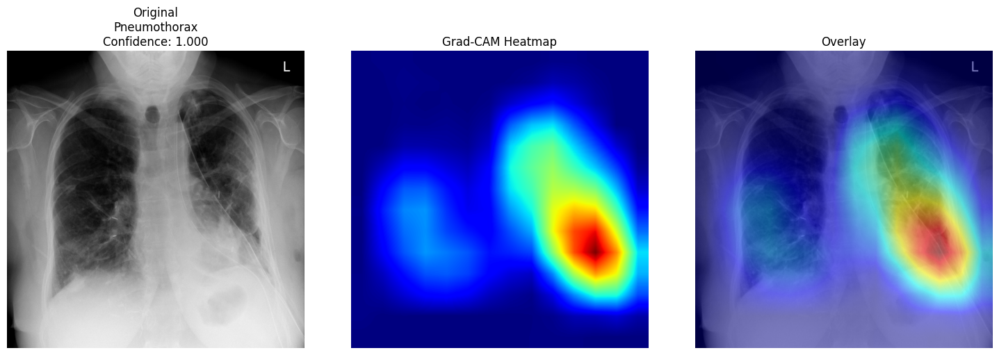


Testing: Edema vs Normal
Dataset: 450 Normal, 346 Edema
   Optimal Threshold: 0.6106
   Accuracy:         0.8668
   F1-Score:         0.8674
   PR-AUC:           0.9002


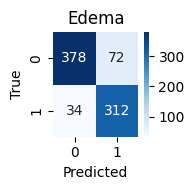


Grad-CAM Visualization for resnet18 - Edema


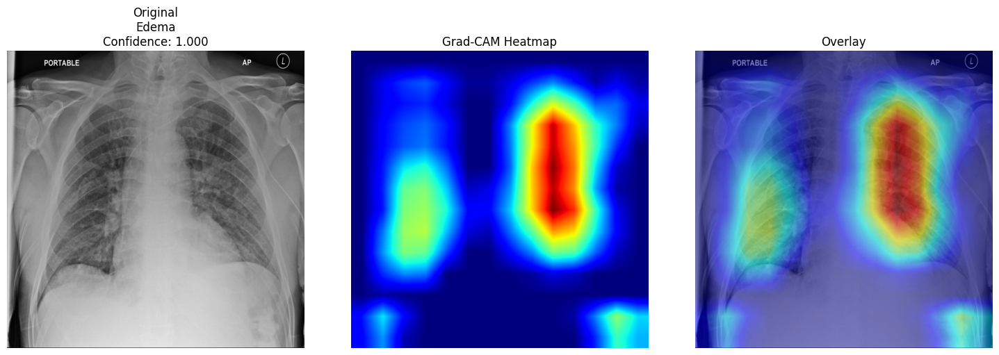

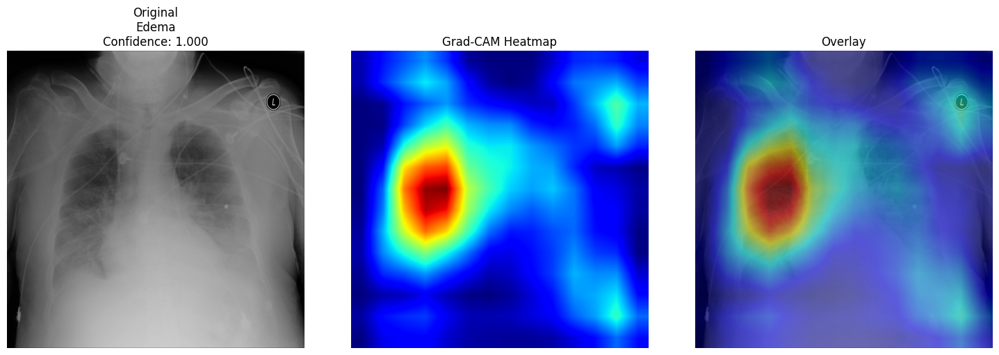

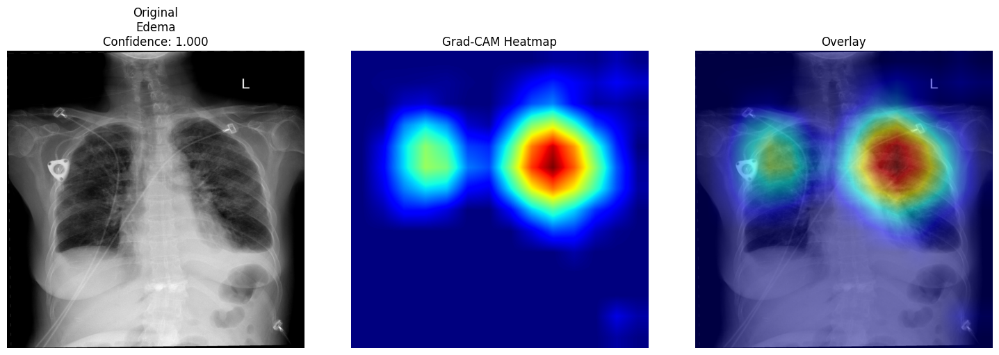

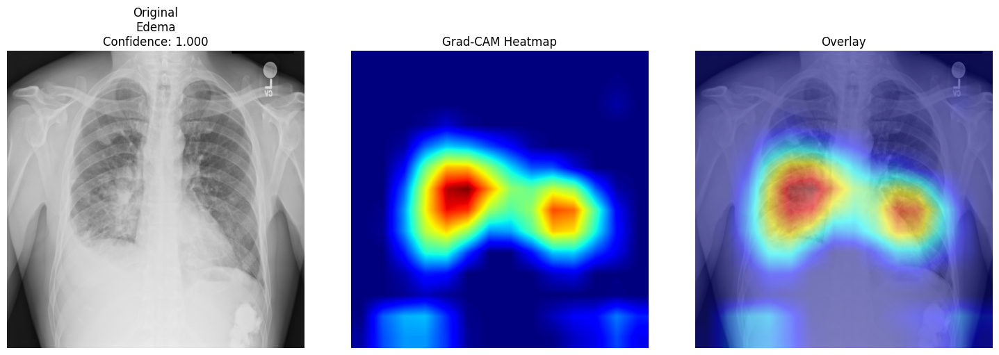

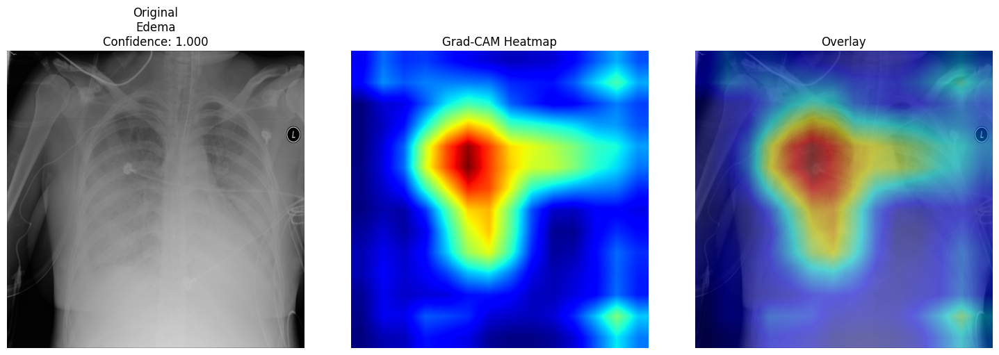


Testing: Cardiomegaly vs Normal
Dataset: 450 Normal, 417 Cardiomegaly
   Optimal Threshold: 0.4814
   Accuracy:         0.8374
   F1-Score:         0.8374
   PR-AUC:           0.9080


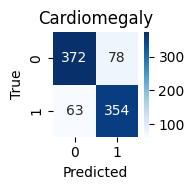


Grad-CAM Visualization for resnet18 - Cardiomegaly


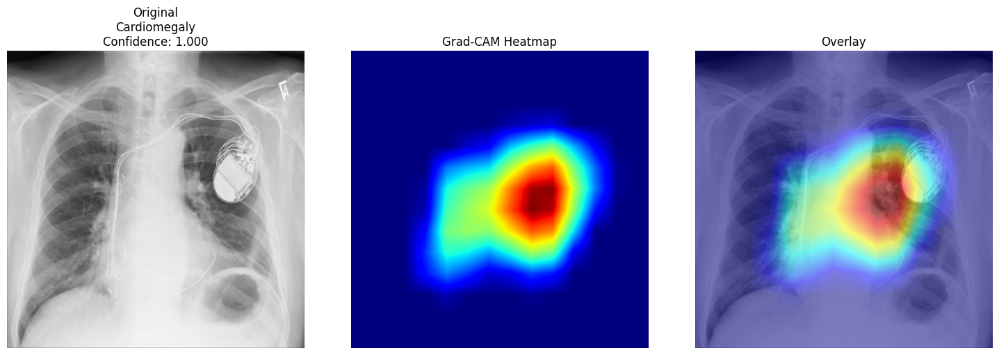

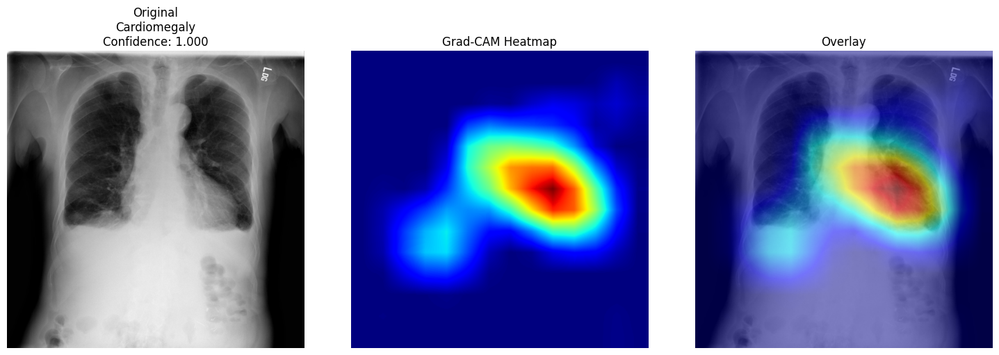

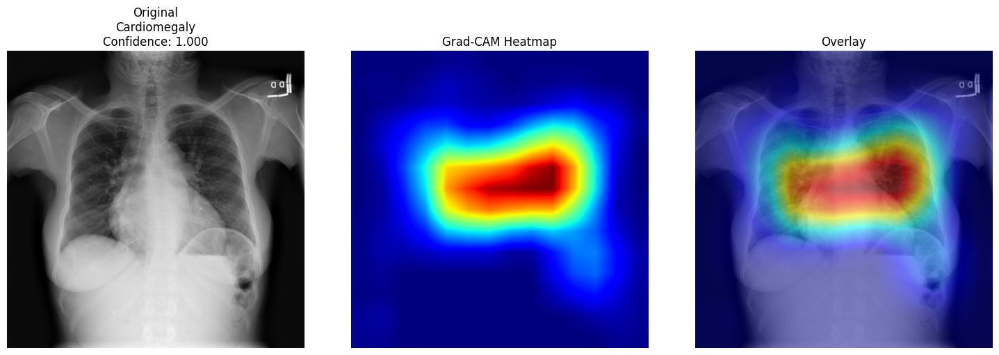

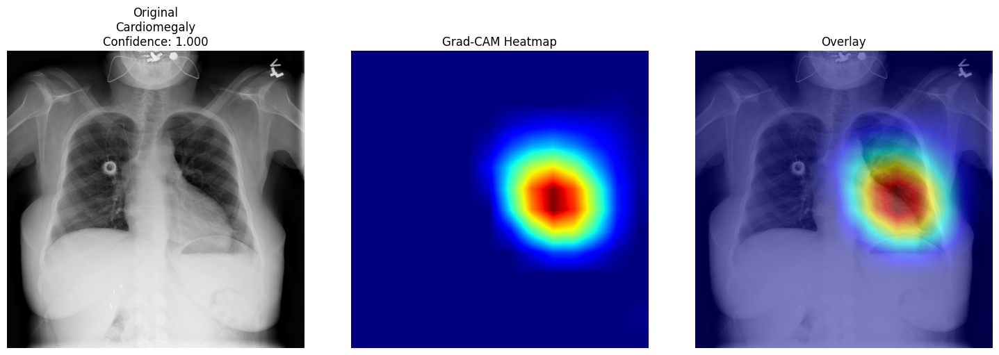

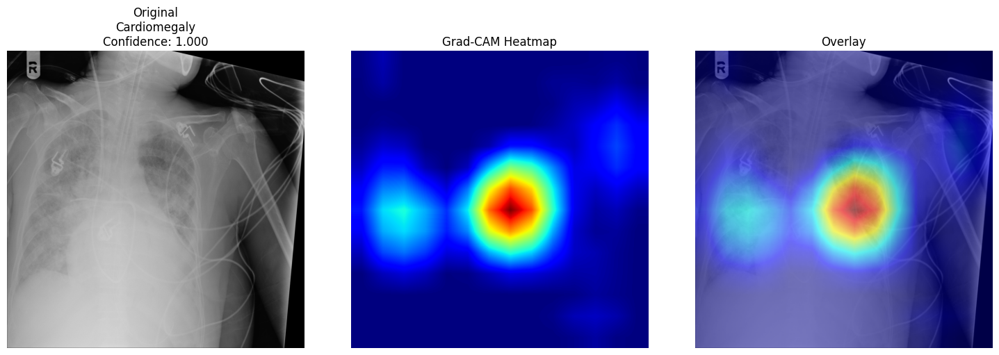

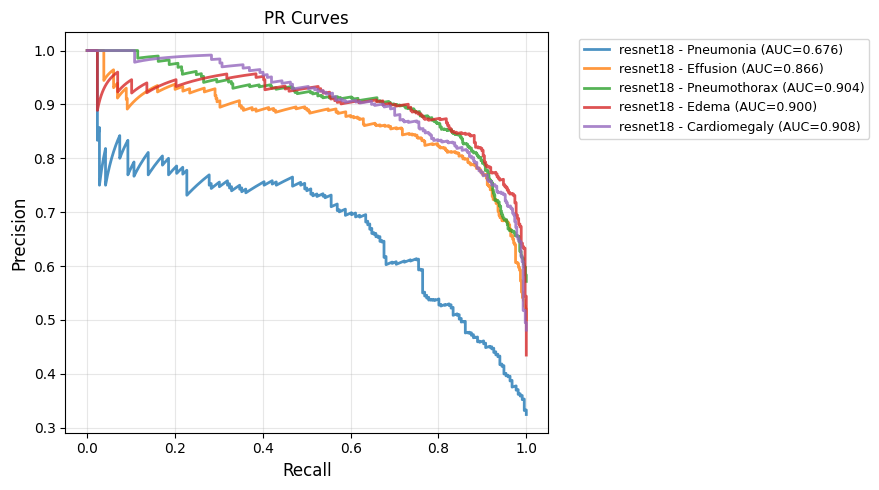


Final test results:
Disease              Accuracy   Precision  Recall     F1         ROC-AUC    PR-AUC    
--------------------------------------------------------------------------------
Pneumonia            0.7613     0.7782     0.7613     0.7662     0.8188     0.6763    
Effusion             0.8011     0.8057     0.8011     0.8004     0.8859     0.8661    
Pneumothorax         0.8076     0.8176     0.8076     0.8086     0.8818     0.9044    
Edema                0.8668     0.8718     0.8668     0.8674     0.9383     0.9002    
Cardiomegaly         0.8374     0.8380     0.8374     0.8374     0.9162     0.9080    
Average              0.8148     0.8223     0.8148     0.8160     0.8882     0.8510    


In [ ]:
models_directory = "/content/resnet"
data_directory = path

main_testing(
    models_dir=models_directory,
    data_dir=data_directory,
    output_dir='testing_results_resnet'
)

Using device: cuda

Testing: Effusion vs Normal
Dataset: 450 Normal, 450 Effusion
   Optimal Threshold: 0.3549
   Accuracy:         0.8167
   F1-Score:         0.8167
   PR-AUC:           0.8571


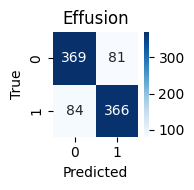


Grad-CAM Visualization for densenet121 - Effusion


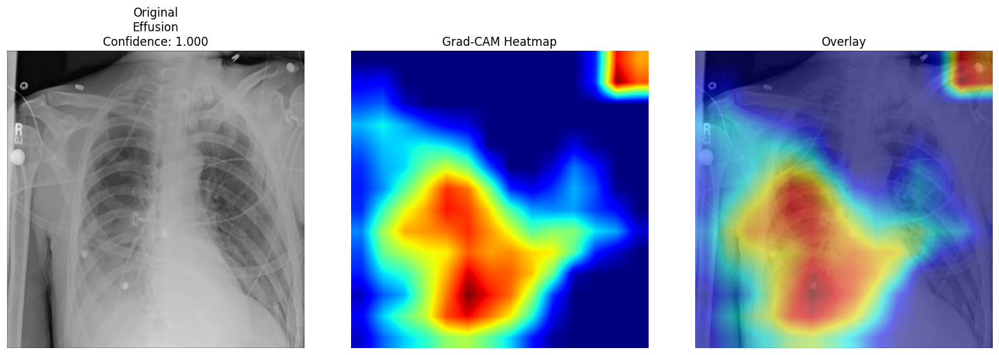

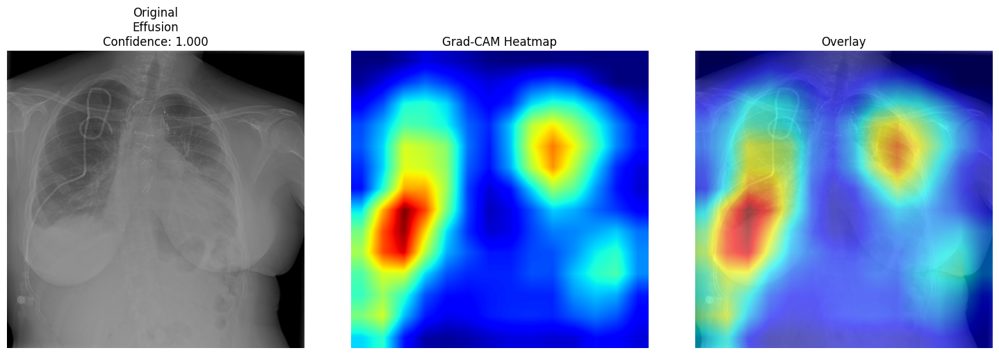

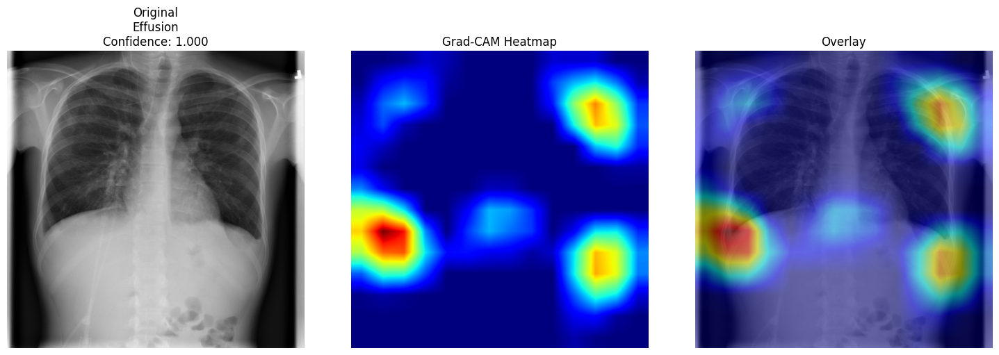

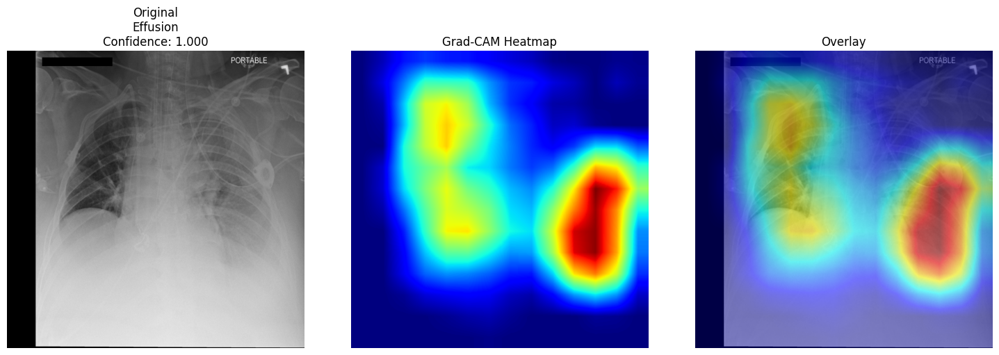

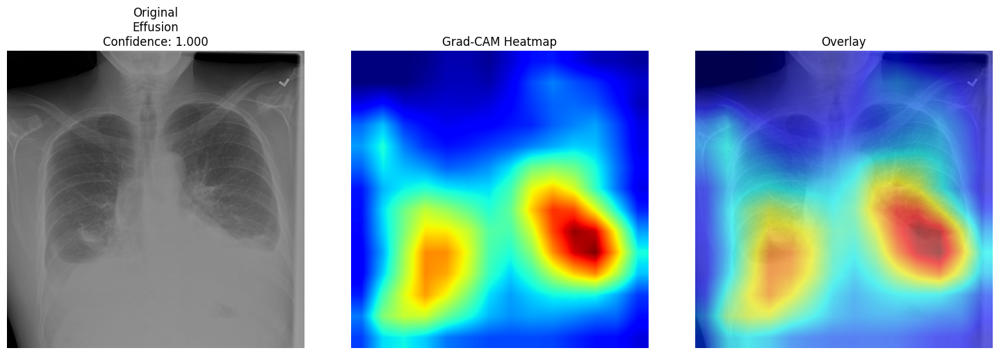


Testing: Cardiomegaly vs Normal
Dataset: 450 Normal, 417 Cardiomegaly
   Optimal Threshold: 0.4161
   Accuracy:         0.8281
   F1-Score:         0.8280
   PR-AUC:           0.9033


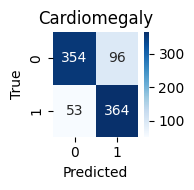


Grad-CAM Visualization for densenet121 - Cardiomegaly


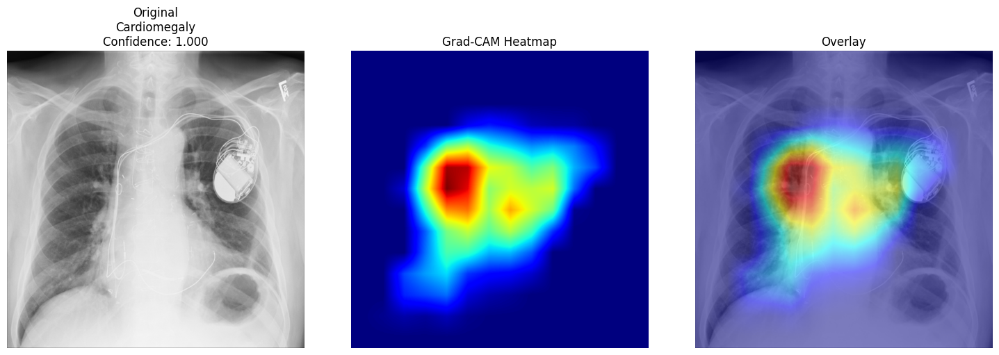

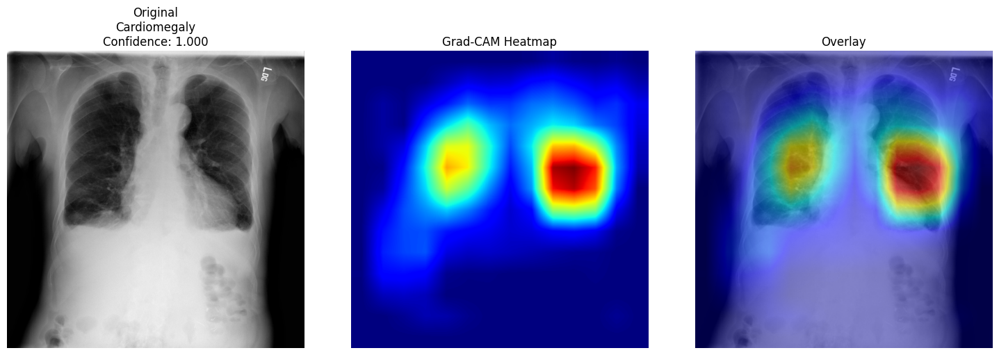

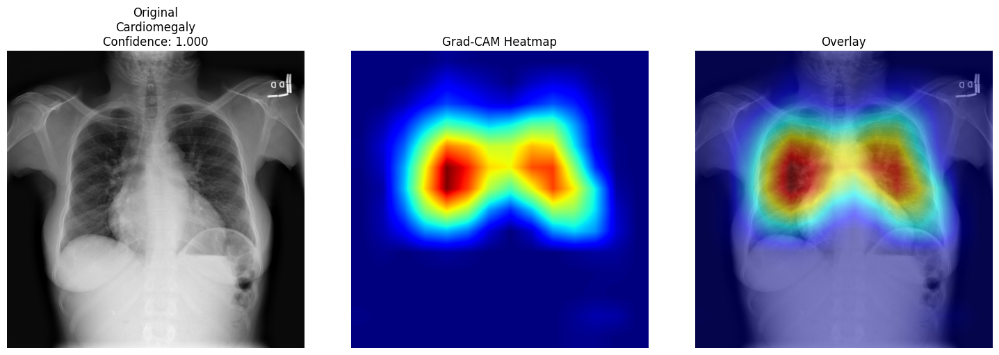

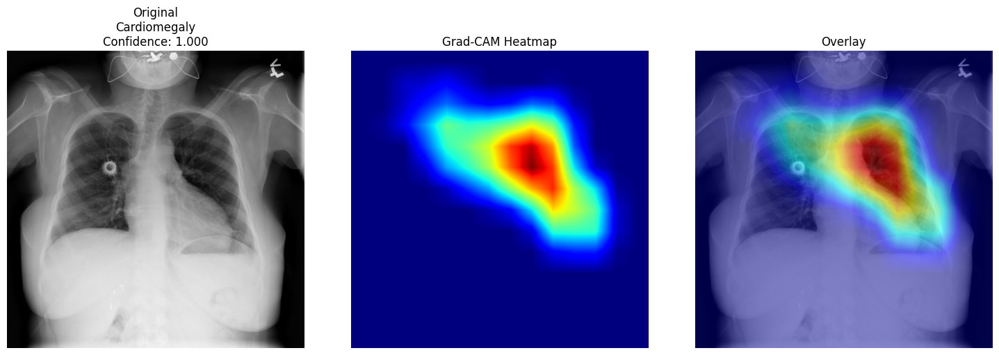

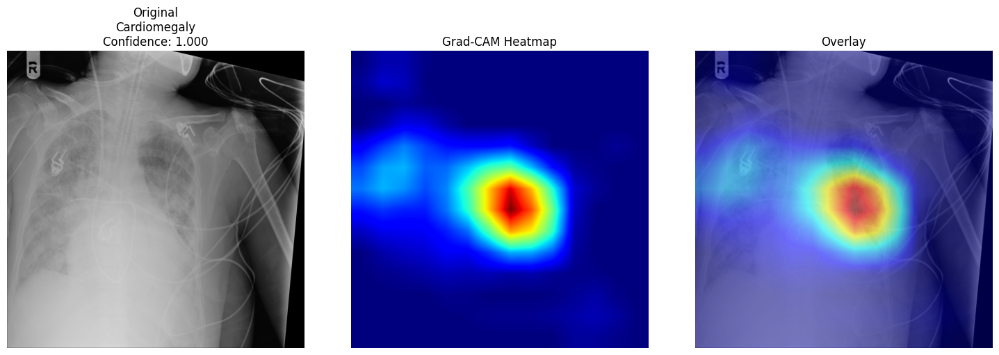


Testing: Edema vs Normal
Dataset: 450 Normal, 346 Edema
   Optimal Threshold: 0.5688
   Accuracy:         0.8719
   F1-Score:         0.8724
   PR-AUC:           0.8983


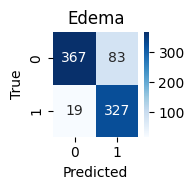


Grad-CAM Visualization for densenet121 - Edema


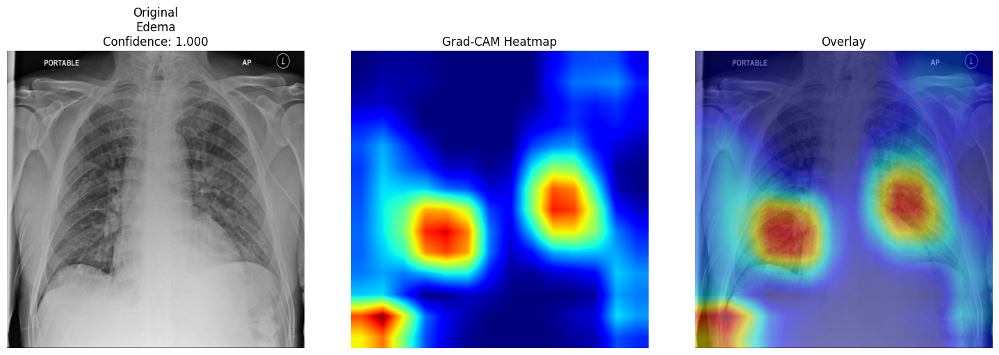

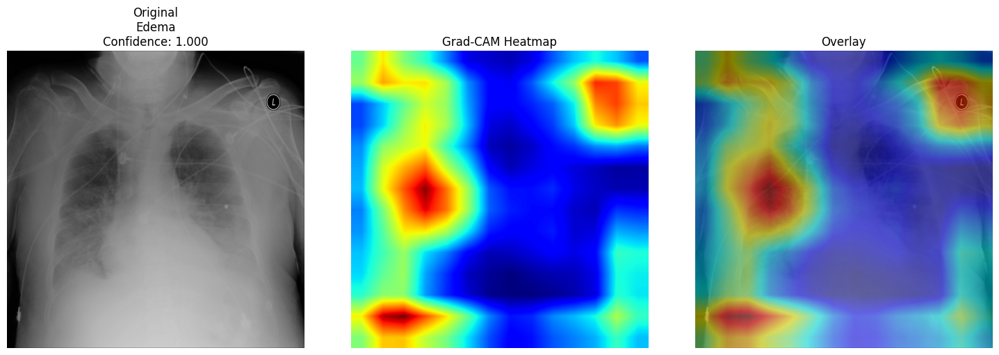

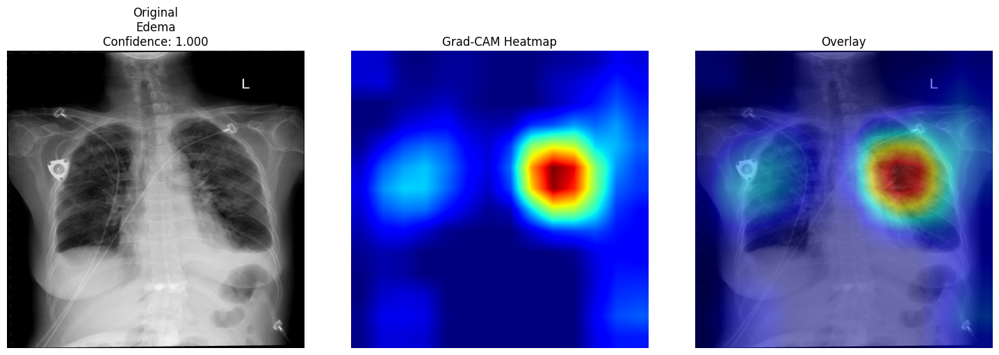

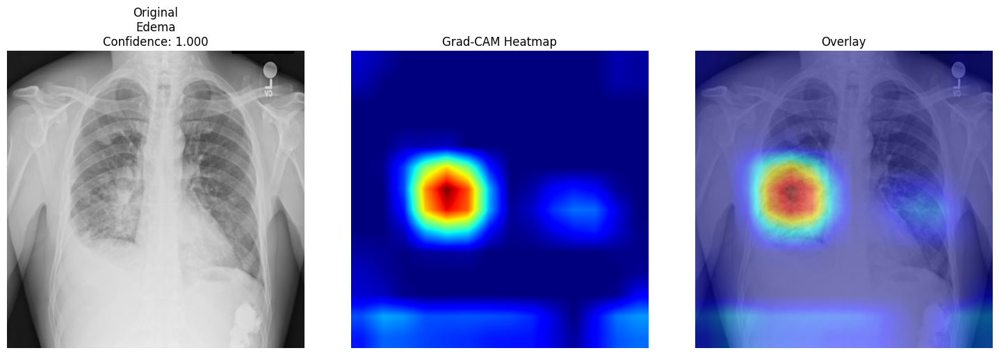

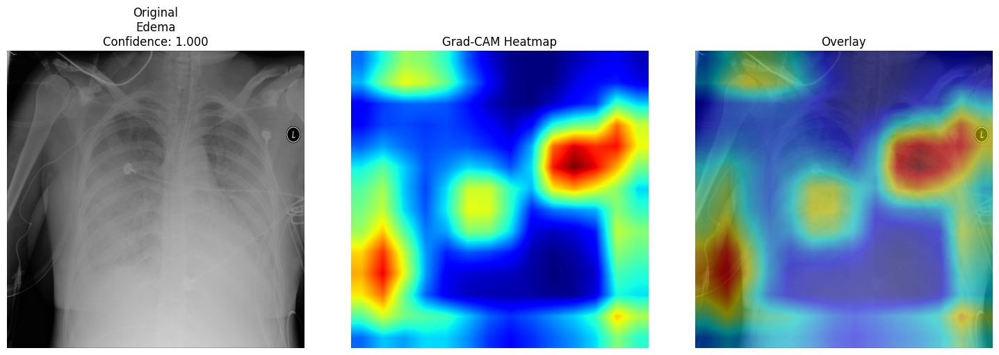


Testing: Pneumonia vs Normal
Dataset: 450 Normal, 216 Pneumonia
   Optimal Threshold: 0.4902
   Accuracy:         0.7523
   F1-Score:         0.7573
   PR-AUC:           0.6700


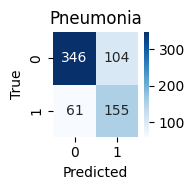


Grad-CAM Visualization for densenet121 - Pneumonia


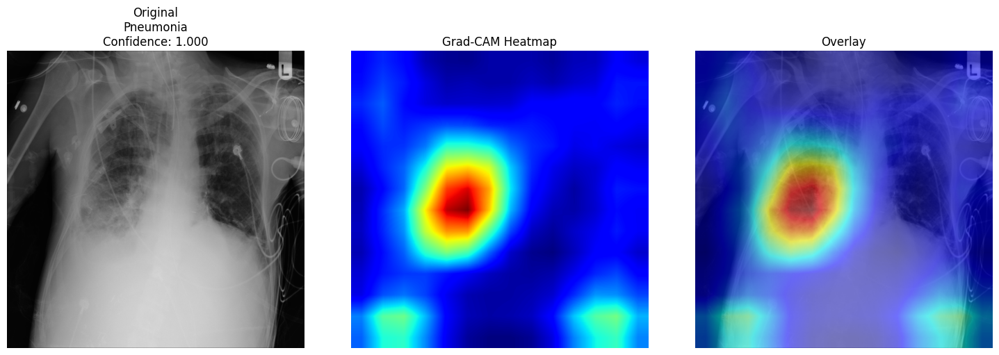

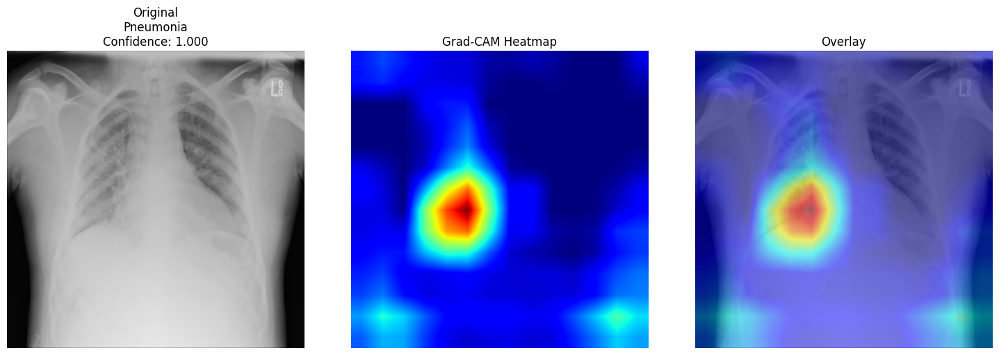

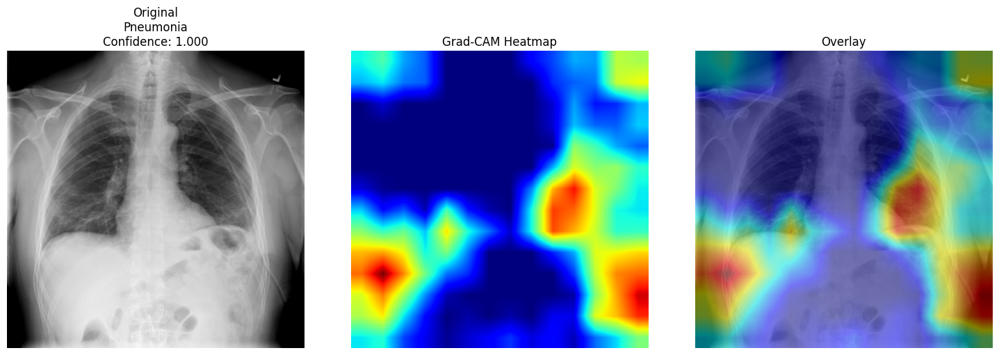

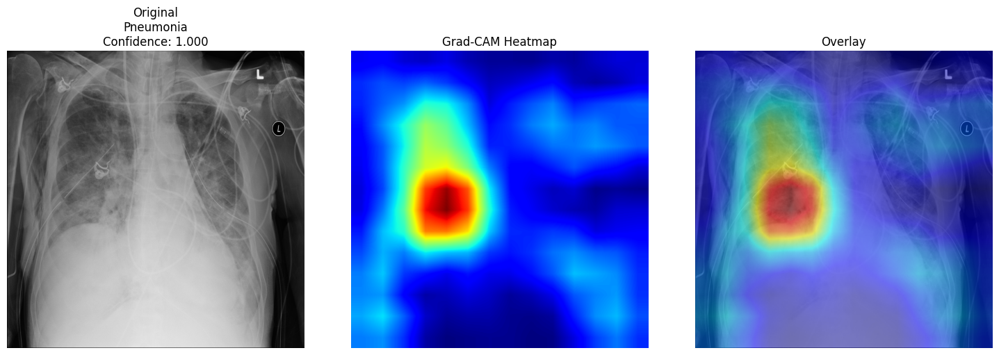

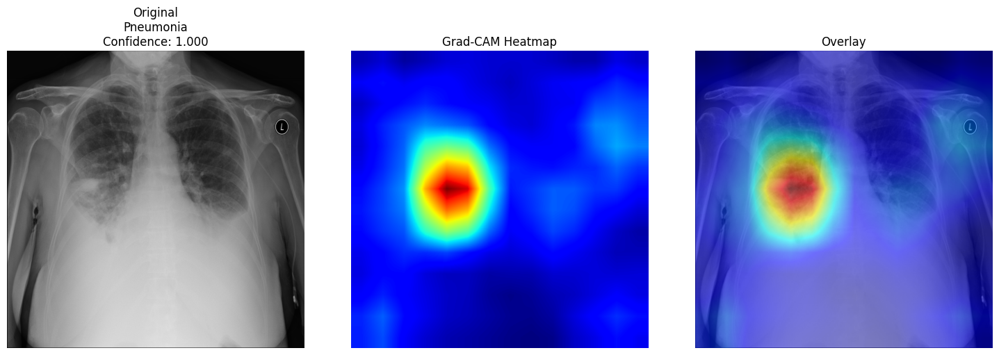


Testing: Pneumothorax vs Normal
Dataset: 450 Normal, 600 Pneumothorax
   Optimal Threshold: 0.3208
   Accuracy:         0.8124
   F1-Score:         0.8128
   PR-AUC:           0.9029


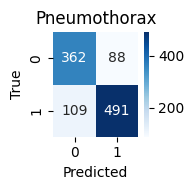


Grad-CAM Visualization for densenet121 - Pneumothorax


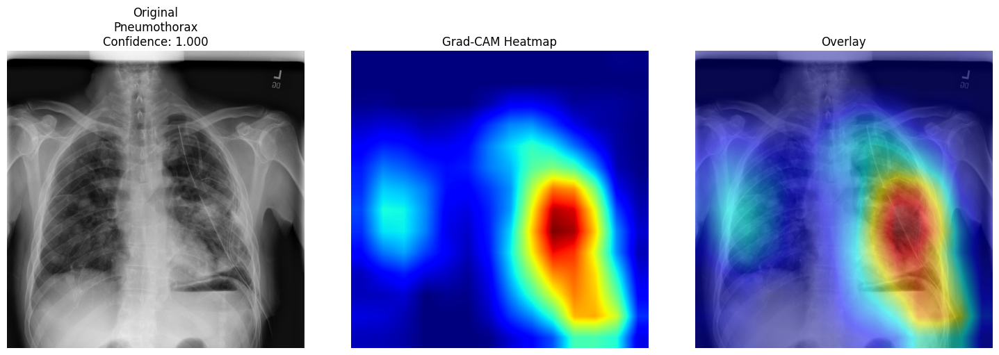

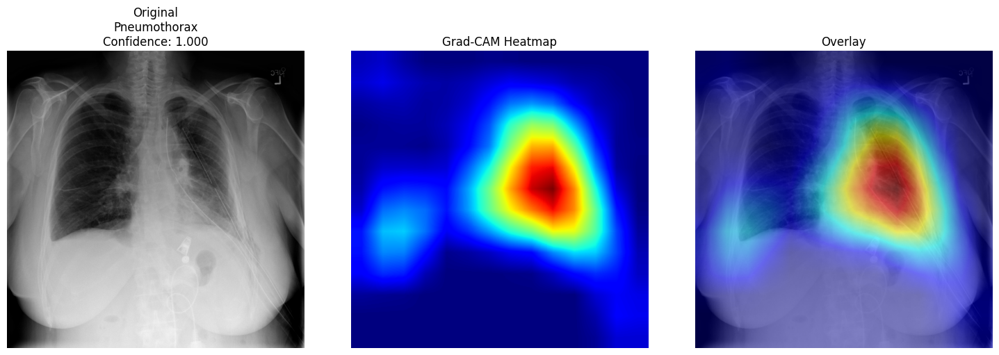

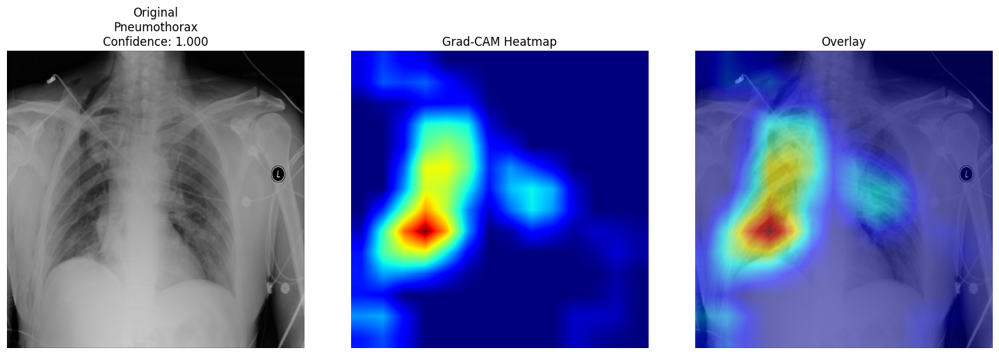

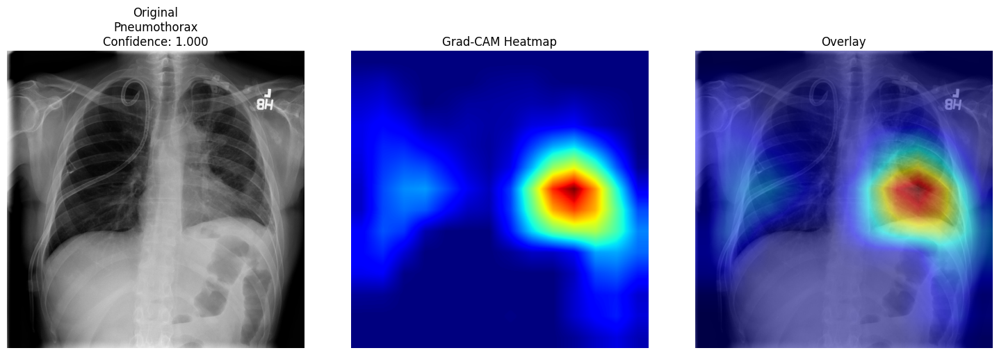

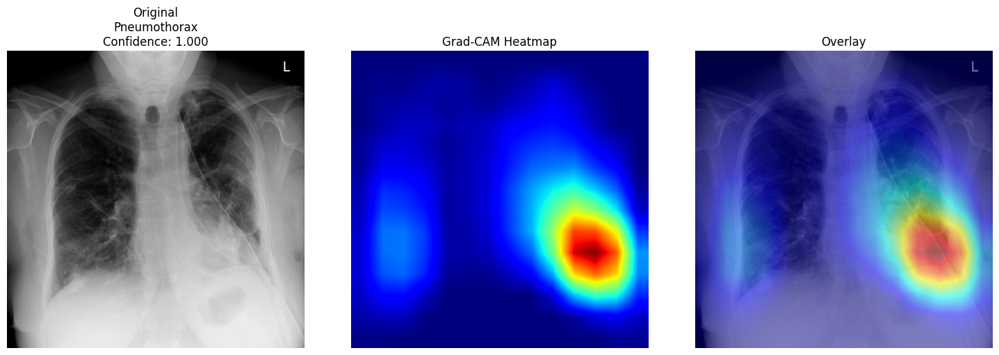

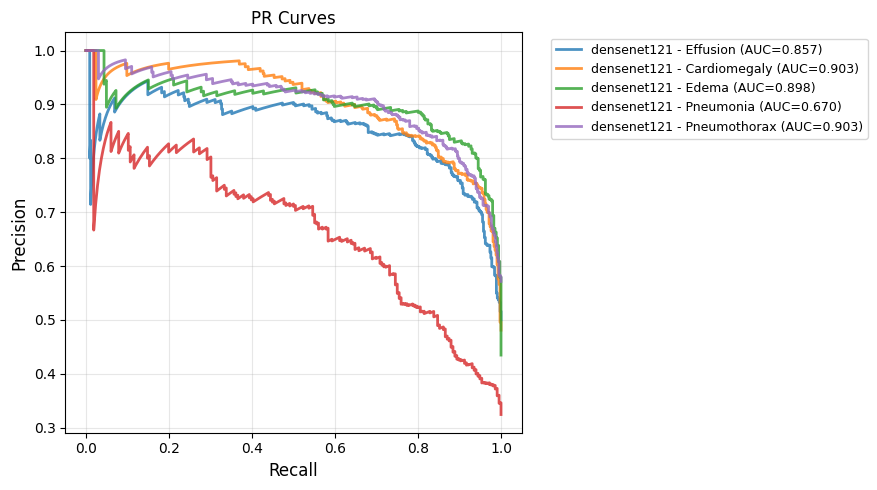


Final test results:
Disease              Accuracy   Precision  Recall     F1         ROC-AUC    PR-AUC    
--------------------------------------------------------------------------------
Effusion             0.8167     0.8167     0.8167     0.8167     0.8841     0.8571    
Cardiomegaly         0.8281     0.8320     0.8281     0.8280     0.9170     0.9033    
Edema                0.8719     0.8842     0.8719     0.8724     0.9401     0.8983    
Pneumonia            0.7523     0.7685     0.7523     0.7573     0.8084     0.6700    
Pneumothorax         0.8124     0.8140     0.8124     0.8128     0.8876     0.9029    
Average              0.8163     0.8231     0.8163     0.8174     0.8874     0.8463    


In [ ]:
models_directory = "/content/densenet"
data_directory = path

main_testing(
    models_dir=models_directory,
    data_dir=data_directory,
    output_dir='testing_results_densenet'
)

In [ ]:
models_directory = "/content/efficientnet"
data_directory = path

main_testing(
    models_dir=models_directory,
    data_dir=data_directory,
    output_dir='testing_results_efficientnet'
)